# Imports

In [2]:
# Data processing
import numpy as np
import pandas as pd

import os

# Pytorch
import torch
import torchvision
from torchvision import datasets, models
from torchvision.transforms import functional as FT
from torchvision import transforms as T
from torch import nn, optim
from torch.nn import functional as F
from torch.utils.data import DataLoader, sampler, random_split, Dataset
from torchvision.utils import draw_bounding_boxes, save_image

# Image processing libs
import copy
import math
from PIL import Image
import cv2
import albumentations as A  

# Adicional libs
import warnings
warnings.filterwarnings("ignore")
from collections import defaultdict, deque
import datetime
import time
from tqdm import tqdm # progress bar


import matplotlib.pyplot as plt
%matplotlib inline

# COCO tools
# Para visualização do arquivo "annotations.coco"
from pycocotools.coco import COCO

# Transformações utilizando albumentations
from albumentations.pytorch import ToTensorV2

# Albumentations Transform

In [4]:
def get_transforms():
    transform = A.Compose([
            A.Resize(600, 600), # Redimensionar a imagem 
            ToTensorV2() # Conversão da imagem para o tipo "torch.tensor"
        ], bbox_params=A.BboxParams(format='coco'))
    return transform

# Dataset

In [5]:
# Classe para a criação do dataset (Treinamento e para realizar a detecção da face)
class FaceDetection(datasets.VisionDataset):
    def __init__(self, root, split='train', transform=None, targetTransform=None, transforms=get_transforms()):
        super().__init__(root, transforms, transform, targetTransform)
        self.split = split # Split do diretório do dataset - EX: Dataset/train por padrão
        self.coco = COCO(os.path.join(root, split, "_annotations.coco.json")) # Arquivo annotations.coco do dataset
        self.ids = list(sorted(self.coco.imgs.keys())) # IDS, no arquivo "annotations.coco" cada imagem recebe um ID
        self.ids = [id for id in self.ids if (len(self._load_target(id)) > 0)]
    
    # Realiza a abertura da imagem
    def _load_image(self, id: int):
        path = self.coco.loadImgs(id)[0]['file_name'] # Nome do arquivo
        image = cv2.imread(os.path.join(self.root, self.split, path)) # Realiza a abertura da imagem com o opencv
        image = cv2.cvtColor(image, cv2.COLOR_BGR2RGB) # Converte a imagem de BGR para RGB
        return image
    
    def _load_target(self, id):
        return self.coco.loadAnns(self.coco.getAnnIds(id))
    
    # Função para realizar a extração de todas as variáveis necessárias do annotations.coco
    def __getitem__(self, index):
        id = self.ids[index] # ID da imagem
        image = self._load_image(id) # Carrega a imagem
        target = self._load_target(id) # Imagem alvo
        target = copy.deepcopy(self._load_target(id)) # Copia da imagem
        
        boxes = [t['bbox'] + [t['category_id']] for t in target] # Bounding box das faces da imagem
        if self.transforms is not None:
            transformed = self.transforms(image=image, bboxes=boxes)
        
        image = transformed['image']
        boxes = transformed['bboxes']
        
        # Realiza a conversão do width e height para coordenadas x e y do canto oposto ao ponto inicial do bounding box
        new_boxes = [] # convert from xywh to xyxy
        for box in boxes:
            xmin = box[0]
            xmax = xmin + box[2]
            ymin = box[1]
            ymax = ymin + box[3]
            new_boxes.append([xmin, ymin, xmax, ymax])
        
        # Realiza a conversão para tensor, para o pytorch
        boxes = torch.tensor(new_boxes, dtype=torch.float32)
        
        # Dict para todas as variáveis obtidas
        targ = {} 
        targ['boxes'] = boxes # Bounding Boxes
        targ['labels'] = torch.tensor([t['category_id'] for t in target], dtype=torch.int64) # Label do bounding box
        targ['image_id'] = torch.tensor([t['image_id'] for t in target]) # Id da imagem alvo
        targ['area'] = (boxes[:, 3] - boxes[:, 1]) * (boxes[:, 2] - boxes[:, 0]) # Área do bounding box
        targ['iscrowd'] = torch.tensor([t['iscrowd'] for t in target], dtype=torch.int64) # Mais de uma face na imagem
        return image.div(255), targ # Realiza a reescala da imagem
    
    # Função para saber a quantidade de imagens no dataset de treinamento ou para detecção
    def __len__(self):
        return len(self.ids)

In [6]:
datasetPath = "./dataset/Faster_RCNN/"

# Carregando as classes para a alteração do output do modelo
coco = COCO(os.path.join(datasetPath, "train", "_annotations.coco.json"))
categories = coco.cats
n_classes = len(categories.keys())

loading annotations into memory...
Done (t=0.00s)
creating index...
index created!


In [8]:
# Criação do dataset de treinamento
train_dataset = FaceDetection(root=datasetPath, transforms=get_transforms())

loading annotations into memory...
Done (t=0.00s)
creating index...
index created!


# Model

In [9]:
# Limpando a memória antes da criação do modelo
import gc
gc.collect()
torch.cuda.empty_cache()

# Carregando o modelo do nosso faster Rcnn
model = models.detection.fasterrcnn_mobilenet_v3_large_fpn(pretrained=True)
# Realizando a troca das layers de saída
# Já que o modelo MobileNetV3-Large foi treinado com 90 classes, e o nosso modelo precisa detectar apenas uma classe
in_features = model.roi_heads.box_predictor.cls_score.in_features
model.roi_heads.box_predictor = models.detection.faster_rcnn.FastRCNNPredictor(in_features, n_classes)

In [10]:
# Função para o agrupamento para o carregamento dos dados de treinamento
# Permitindo criarmos batches para o treinamento do modelo
def collate_fn(batch):
    return tuple(zip(*batch))

In [11]:
# Realizando o carregamento das imagens para o treinamento
train_loader = DataLoader(train_dataset, batch_size=4, shuffle=True, collate_fn=collate_fn)

In [12]:
# As linhas de código presente nesta célula
# Garante que o modelo irá realizar o treinamento e não irá crashar durante o treinamento

images,targets = next(iter(train_loader))
images = list(image for image in images)
targets = [{k:v for k, v in t.items()} for t in targets]
output = model(images, targets)
device = torch.device("cuda") # Utiliza a GPU para o treinamento
model = model.to(device)

# Optimizer

In [13]:
# Optimizador para o treinamento
# Utilizando Stochastic Gradient Descent
params = [p for p in model.parameters() if p.requires_grad]
optimizer = torch.optim.SGD(params, lr=0.01, momentum=0.9, nesterov=True, weight_decay=1e-4)
# lr_scheduler = torch.optim.lr_scheduler.MultiStepLR(optimizer, milestones=[16, 22], gamma=0.1) # lr scheduler

# Training

In [14]:
# Função para realizar o treinamento de um epoch
# Número de epochs definidos pelo usuário
def train_one_epoch(model, optimizer, loader, device, epoch):
    model.train() # Treina o modelo
    
    # Loss de cada epoch do treinamento
    all_losses = []
    all_losses_dict = []

    for images, targets in tqdm(loader): # Progressive bar (tqdm)
        # Imagens para o treinamento
        images = list(image.to(device) for image in images)
        targets = [{k: torch.tensor(v).to(device) for k, v in t.items()} for t in targets]
        
        # Cálculo da loss 
        loss_dict = model(images, targets) # the model computes the loss automatically if we pass in targets
        losses = sum(loss for loss in loss_dict.values())
        loss_dict_append = {k: v.item() for k, v in loss_dict.items()}
        loss_value = losses.item()
        
        # Armazenando a loss
        all_losses.append(loss_value)
        all_losses_dict.append(loss_dict_append)
        
        # Realiza a verificação se a loss se tornou infinita, e para o treinamento
        if not math.isfinite(loss_value):
            print(f"Loss is {loss_value}, stopping trainig")
            print(loss_dict)
            sys.exit(1)
        
        # Optimizador do treinamento
        optimizer.zero_grad()
        losses.backward()
        optimizer.step()
        
    # Informações demonstradas para o usuário a cada epoch do treinamento
    all_losses_dict = pd.DataFrame(all_losses_dict)
    print("Epoch {}, lr: {:.6f}, loss: {:.6f}, loss_classifier: {:.6f}, loss_box: {:.6f}, loss_rpn_box: {:.6f}, loss_object: {:.6f}".format(
        epoch, optimizer.param_groups[0]['lr'], np.mean(all_losses),
        all_losses_dict['loss_classifier'].mean(),
        all_losses_dict['loss_box_reg'].mean(),
        all_losses_dict['loss_rpn_box_reg'].mean(),
        all_losses_dict['loss_objectness'].mean()
    ))
    
    return np.mean(all_losses)

In [15]:
epoch = 0
loss = 1

# Realiza o treinamento do modelo baseado no numero de epochs escolhido pelo usuário
start_time = time.time()
while(loss > 0.15):
    loss = train_one_epoch(model, optimizer, train_loader, device, epoch)
    epoch = epoch + 1
#     lr_scheduler.step()
print("CNN - %s seconds" % (time.time() - start_time))

100%|██████████| 13/13 [00:10<00:00,  1.26it/s]


Epoch 0, lr: 0.010000, loss: 0.491252, loss_classifier: 0.211352, loss_box: 0.157749, loss_rpn_box: 0.015376, loss_object: 0.106775


100%|██████████| 13/13 [00:03<00:00,  3.31it/s]


Epoch 1, lr: 0.010000, loss: 0.643473, loss_classifier: 0.220628, loss_box: 0.384583, loss_rpn_box: 0.009862, loss_object: 0.028400


100%|██████████| 13/13 [00:03<00:00,  3.46it/s]


Epoch 2, lr: 0.010000, loss: 0.763137, loss_classifier: 0.232508, loss_box: 0.508399, loss_rpn_box: 0.009375, loss_object: 0.012854


100%|██████████| 13/13 [00:03<00:00,  3.50it/s]


Epoch 3, lr: 0.010000, loss: 0.700221, loss_classifier: 0.214872, loss_box: 0.469626, loss_rpn_box: 0.006446, loss_object: 0.009277


100%|██████████| 13/13 [00:03<00:00,  3.45it/s]


Epoch 4, lr: 0.010000, loss: 0.525492, loss_classifier: 0.152471, loss_box: 0.356744, loss_rpn_box: 0.006127, loss_object: 0.010151


100%|██████████| 13/13 [00:03<00:00,  3.52it/s]


Epoch 5, lr: 0.010000, loss: 0.410581, loss_classifier: 0.124909, loss_box: 0.275288, loss_rpn_box: 0.003979, loss_object: 0.006405


100%|██████████| 13/13 [00:03<00:00,  3.69it/s]


Epoch 6, lr: 0.010000, loss: 0.501070, loss_classifier: 0.140438, loss_box: 0.350845, loss_rpn_box: 0.004371, loss_object: 0.005417


100%|██████████| 13/13 [00:03<00:00,  3.71it/s]


Epoch 7, lr: 0.010000, loss: 0.481319, loss_classifier: 0.141173, loss_box: 0.332026, loss_rpn_box: 0.003717, loss_object: 0.004403


100%|██████████| 13/13 [00:03<00:00,  3.73it/s]


Epoch 8, lr: 0.010000, loss: 0.517920, loss_classifier: 0.157080, loss_box: 0.351297, loss_rpn_box: 0.004319, loss_object: 0.005224


100%|██████████| 13/13 [00:03<00:00,  3.72it/s]


Epoch 9, lr: 0.010000, loss: 0.503930, loss_classifier: 0.131544, loss_box: 0.364409, loss_rpn_box: 0.003352, loss_object: 0.004626


100%|██████████| 13/13 [00:03<00:00,  3.53it/s]


Epoch 10, lr: 0.010000, loss: 0.443107, loss_classifier: 0.121549, loss_box: 0.314387, loss_rpn_box: 0.002749, loss_object: 0.004422


100%|██████████| 13/13 [00:03<00:00,  3.71it/s]


Epoch 11, lr: 0.010000, loss: 0.416177, loss_classifier: 0.118925, loss_box: 0.291486, loss_rpn_box: 0.002243, loss_object: 0.003523


100%|██████████| 13/13 [00:03<00:00,  3.70it/s]


Epoch 12, lr: 0.010000, loss: 0.478452, loss_classifier: 0.132760, loss_box: 0.339785, loss_rpn_box: 0.002215, loss_object: 0.003691


100%|██████████| 13/13 [00:03<00:00,  3.52it/s]


Epoch 13, lr: 0.010000, loss: 0.439690, loss_classifier: 0.137257, loss_box: 0.296659, loss_rpn_box: 0.002250, loss_object: 0.003524


100%|██████████| 13/13 [00:03<00:00,  3.71it/s]


Epoch 14, lr: 0.010000, loss: 0.505281, loss_classifier: 0.141722, loss_box: 0.358332, loss_rpn_box: 0.002204, loss_object: 0.003022


100%|██████████| 13/13 [00:03<00:00,  3.71it/s]


Epoch 15, lr: 0.010000, loss: 0.629847, loss_classifier: 0.183611, loss_box: 0.439340, loss_rpn_box: 0.002483, loss_object: 0.004412


100%|██████████| 13/13 [00:03<00:00,  3.30it/s]


Epoch 16, lr: 0.010000, loss: 0.451267, loss_classifier: 0.158696, loss_box: 0.286539, loss_rpn_box: 0.002578, loss_object: 0.003454


100%|██████████| 13/13 [00:03<00:00,  3.63it/s]


Epoch 17, lr: 0.010000, loss: 0.502506, loss_classifier: 0.155865, loss_box: 0.340365, loss_rpn_box: 0.002460, loss_object: 0.003816


100%|██████████| 13/13 [00:03<00:00,  3.49it/s]


Epoch 18, lr: 0.010000, loss: 0.385346, loss_classifier: 0.132926, loss_box: 0.245549, loss_rpn_box: 0.002799, loss_object: 0.004071


100%|██████████| 13/13 [00:03<00:00,  3.54it/s]


Epoch 19, lr: 0.010000, loss: 0.374182, loss_classifier: 0.112388, loss_box: 0.256525, loss_rpn_box: 0.002001, loss_object: 0.003269


100%|██████████| 13/13 [00:03<00:00,  3.68it/s]


Epoch 20, lr: 0.010000, loss: 0.417827, loss_classifier: 0.111720, loss_box: 0.301412, loss_rpn_box: 0.001985, loss_object: 0.002710


100%|██████████| 13/13 [00:03<00:00,  3.62it/s]


Epoch 21, lr: 0.010000, loss: 0.512555, loss_classifier: 0.116706, loss_box: 0.390598, loss_rpn_box: 0.002579, loss_object: 0.002673


100%|██████████| 13/13 [00:03<00:00,  3.30it/s]


Epoch 22, lr: 0.010000, loss: 0.421116, loss_classifier: 0.123604, loss_box: 0.291865, loss_rpn_box: 0.002325, loss_object: 0.003322


100%|██████████| 13/13 [00:04<00:00,  3.07it/s]


Epoch 23, lr: 0.010000, loss: 0.391021, loss_classifier: 0.110944, loss_box: 0.275928, loss_rpn_box: 0.001326, loss_object: 0.002823


100%|██████████| 13/13 [00:03<00:00,  3.25it/s]


Epoch 24, lr: 0.010000, loss: 0.428091, loss_classifier: 0.110415, loss_box: 0.313690, loss_rpn_box: 0.001188, loss_object: 0.002797


100%|██████████| 13/13 [00:03<00:00,  3.76it/s]


Epoch 25, lr: 0.010000, loss: 0.422050, loss_classifier: 0.118874, loss_box: 0.299499, loss_rpn_box: 0.001422, loss_object: 0.002255


100%|██████████| 13/13 [00:03<00:00,  3.45it/s]


Epoch 26, lr: 0.010000, loss: 0.396091, loss_classifier: 0.112360, loss_box: 0.279308, loss_rpn_box: 0.001730, loss_object: 0.002693


100%|██████████| 13/13 [00:03<00:00,  3.61it/s]


Epoch 27, lr: 0.010000, loss: 0.388784, loss_classifier: 0.118708, loss_box: 0.266690, loss_rpn_box: 0.001259, loss_object: 0.002127


100%|██████████| 13/13 [00:03<00:00,  3.59it/s]


Epoch 28, lr: 0.010000, loss: 0.361502, loss_classifier: 0.098239, loss_box: 0.259489, loss_rpn_box: 0.001228, loss_object: 0.002546


100%|██████████| 13/13 [00:03<00:00,  3.48it/s]


Epoch 29, lr: 0.010000, loss: 0.338281, loss_classifier: 0.089081, loss_box: 0.246075, loss_rpn_box: 0.001038, loss_object: 0.002086


100%|██████████| 13/13 [00:03<00:00,  3.62it/s]


Epoch 30, lr: 0.010000, loss: 0.349857, loss_classifier: 0.090440, loss_box: 0.255091, loss_rpn_box: 0.001213, loss_object: 0.003113


100%|██████████| 13/13 [00:03<00:00,  3.66it/s]


Epoch 31, lr: 0.010000, loss: 0.350901, loss_classifier: 0.093175, loss_box: 0.254424, loss_rpn_box: 0.001259, loss_object: 0.002043


100%|██████████| 13/13 [00:03<00:00,  3.82it/s]


Epoch 32, lr: 0.010000, loss: 0.387259, loss_classifier: 0.116614, loss_box: 0.267196, loss_rpn_box: 0.001326, loss_object: 0.002123


100%|██████████| 13/13 [00:03<00:00,  3.82it/s]


Epoch 33, lr: 0.010000, loss: 0.303768, loss_classifier: 0.093682, loss_box: 0.206311, loss_rpn_box: 0.001061, loss_object: 0.002714


100%|██████████| 13/13 [00:03<00:00,  3.85it/s]


Epoch 34, lr: 0.010000, loss: 0.328767, loss_classifier: 0.095765, loss_box: 0.229426, loss_rpn_box: 0.001091, loss_object: 0.002485


100%|██████████| 13/13 [00:03<00:00,  3.86it/s]


Epoch 35, lr: 0.010000, loss: 0.402219, loss_classifier: 0.114063, loss_box: 0.285097, loss_rpn_box: 0.001046, loss_object: 0.002013


100%|██████████| 13/13 [00:03<00:00,  3.87it/s]


Epoch 36, lr: 0.010000, loss: 0.392917, loss_classifier: 0.112491, loss_box: 0.277581, loss_rpn_box: 0.000938, loss_object: 0.001907


100%|██████████| 13/13 [00:03<00:00,  3.88it/s]


Epoch 37, lr: 0.010000, loss: 0.345535, loss_classifier: 0.097229, loss_box: 0.245087, loss_rpn_box: 0.001008, loss_object: 0.002211


100%|██████████| 13/13 [00:03<00:00,  3.86it/s]


Epoch 38, lr: 0.010000, loss: 0.375846, loss_classifier: 0.095333, loss_box: 0.277205, loss_rpn_box: 0.000929, loss_object: 0.002380


100%|██████████| 13/13 [00:03<00:00,  3.81it/s]


Epoch 39, lr: 0.010000, loss: 0.342908, loss_classifier: 0.096200, loss_box: 0.242988, loss_rpn_box: 0.001096, loss_object: 0.002624


100%|██████████| 13/13 [00:03<00:00,  3.87it/s]


Epoch 40, lr: 0.010000, loss: 0.399025, loss_classifier: 0.101805, loss_box: 0.293586, loss_rpn_box: 0.001117, loss_object: 0.002516


100%|██████████| 13/13 [00:03<00:00,  3.86it/s]


Epoch 41, lr: 0.010000, loss: 0.344169, loss_classifier: 0.099632, loss_box: 0.241036, loss_rpn_box: 0.000963, loss_object: 0.002538


100%|██████████| 13/13 [00:03<00:00,  3.79it/s]


Epoch 42, lr: 0.010000, loss: 0.303312, loss_classifier: 0.080079, loss_box: 0.220143, loss_rpn_box: 0.000839, loss_object: 0.002251


100%|██████████| 13/13 [00:03<00:00,  3.83it/s]


Epoch 43, lr: 0.010000, loss: 0.277465, loss_classifier: 0.086776, loss_box: 0.187463, loss_rpn_box: 0.000704, loss_object: 0.002522


100%|██████████| 13/13 [00:03<00:00,  3.78it/s]


Epoch 44, lr: 0.010000, loss: 0.316610, loss_classifier: 0.086759, loss_box: 0.226949, loss_rpn_box: 0.000697, loss_object: 0.002205


100%|██████████| 13/13 [00:03<00:00,  3.90it/s]


Epoch 45, lr: 0.010000, loss: 0.329017, loss_classifier: 0.090862, loss_box: 0.235550, loss_rpn_box: 0.000733, loss_object: 0.001872


100%|██████████| 13/13 [00:03<00:00,  3.83it/s]


Epoch 46, lr: 0.010000, loss: 0.276536, loss_classifier: 0.083533, loss_box: 0.190115, loss_rpn_box: 0.000784, loss_object: 0.002104


100%|██████████| 13/13 [00:03<00:00,  3.82it/s]


Epoch 47, lr: 0.010000, loss: 0.279412, loss_classifier: 0.087146, loss_box: 0.189872, loss_rpn_box: 0.000662, loss_object: 0.001732


100%|██████████| 13/13 [00:03<00:00,  3.88it/s]


Epoch 48, lr: 0.010000, loss: 0.285151, loss_classifier: 0.083281, loss_box: 0.199339, loss_rpn_box: 0.000653, loss_object: 0.001877


100%|██████████| 13/13 [00:03<00:00,  3.87it/s]


Epoch 49, lr: 0.010000, loss: 0.301419, loss_classifier: 0.080447, loss_box: 0.218035, loss_rpn_box: 0.000843, loss_object: 0.002094


100%|██████████| 13/13 [00:03<00:00,  3.88it/s]


Epoch 50, lr: 0.010000, loss: 0.286096, loss_classifier: 0.077128, loss_box: 0.206032, loss_rpn_box: 0.000660, loss_object: 0.002276


100%|██████████| 13/13 [00:03<00:00,  3.90it/s]


Epoch 51, lr: 0.010000, loss: 0.282703, loss_classifier: 0.078219, loss_box: 0.201677, loss_rpn_box: 0.000655, loss_object: 0.002152


100%|██████████| 13/13 [00:03<00:00,  3.90it/s]


Epoch 52, lr: 0.010000, loss: 0.262534, loss_classifier: 0.076451, loss_box: 0.183720, loss_rpn_box: 0.000722, loss_object: 0.001641


100%|██████████| 13/13 [00:03<00:00,  3.87it/s]


Epoch 53, lr: 0.010000, loss: 0.270070, loss_classifier: 0.084580, loss_box: 0.182470, loss_rpn_box: 0.000969, loss_object: 0.002051


100%|██████████| 13/13 [00:03<00:00,  3.84it/s]


Epoch 54, lr: 0.010000, loss: 0.301495, loss_classifier: 0.074189, loss_box: 0.223873, loss_rpn_box: 0.000728, loss_object: 0.002705


100%|██████████| 13/13 [00:03<00:00,  3.89it/s]


Epoch 55, lr: 0.010000, loss: 0.334556, loss_classifier: 0.093081, loss_box: 0.238017, loss_rpn_box: 0.000916, loss_object: 0.002542


100%|██████████| 13/13 [00:03<00:00,  3.87it/s]


Epoch 56, lr: 0.010000, loss: 0.291444, loss_classifier: 0.081128, loss_box: 0.207377, loss_rpn_box: 0.001016, loss_object: 0.001922


100%|██████████| 13/13 [00:03<00:00,  3.90it/s]


Epoch 57, lr: 0.010000, loss: 0.284550, loss_classifier: 0.081556, loss_box: 0.200163, loss_rpn_box: 0.000676, loss_object: 0.002156


100%|██████████| 13/13 [00:03<00:00,  3.91it/s]


Epoch 58, lr: 0.010000, loss: 0.296577, loss_classifier: 0.079329, loss_box: 0.214969, loss_rpn_box: 0.000636, loss_object: 0.001643


100%|██████████| 13/13 [00:03<00:00,  3.88it/s]


Epoch 59, lr: 0.010000, loss: 0.274612, loss_classifier: 0.081022, loss_box: 0.190902, loss_rpn_box: 0.000563, loss_object: 0.002125


100%|██████████| 13/13 [00:03<00:00,  3.79it/s]


Epoch 60, lr: 0.010000, loss: 0.240586, loss_classifier: 0.083940, loss_box: 0.154182, loss_rpn_box: 0.000541, loss_object: 0.001923


100%|██████████| 13/13 [00:03<00:00,  3.89it/s]


Epoch 61, lr: 0.010000, loss: 0.249703, loss_classifier: 0.071141, loss_box: 0.175898, loss_rpn_box: 0.000712, loss_object: 0.001952


100%|██████████| 13/13 [00:03<00:00,  3.90it/s]


Epoch 62, lr: 0.010000, loss: 0.257546, loss_classifier: 0.067814, loss_box: 0.187555, loss_rpn_box: 0.000584, loss_object: 0.001594


100%|██████████| 13/13 [00:03<00:00,  3.88it/s]


Epoch 63, lr: 0.010000, loss: 0.297670, loss_classifier: 0.086098, loss_box: 0.208982, loss_rpn_box: 0.000607, loss_object: 0.001983


100%|██████████| 13/13 [00:03<00:00,  3.88it/s]


Epoch 64, lr: 0.010000, loss: 0.257779, loss_classifier: 0.072049, loss_box: 0.181176, loss_rpn_box: 0.000873, loss_object: 0.003682


100%|██████████| 13/13 [00:03<00:00,  3.90it/s]


Epoch 65, lr: 0.010000, loss: 0.251452, loss_classifier: 0.071987, loss_box: 0.177011, loss_rpn_box: 0.000698, loss_object: 0.001757


100%|██████████| 13/13 [00:03<00:00,  3.87it/s]


Epoch 66, lr: 0.010000, loss: 0.246087, loss_classifier: 0.073735, loss_box: 0.169352, loss_rpn_box: 0.001092, loss_object: 0.001908


100%|██████████| 13/13 [00:03<00:00,  3.90it/s]


Epoch 67, lr: 0.010000, loss: 0.236883, loss_classifier: 0.064412, loss_box: 0.170112, loss_rpn_box: 0.000722, loss_object: 0.001637


100%|██████████| 13/13 [00:03<00:00,  3.91it/s]


Epoch 68, lr: 0.010000, loss: 0.266459, loss_classifier: 0.072027, loss_box: 0.192306, loss_rpn_box: 0.000564, loss_object: 0.001563


100%|██████████| 13/13 [00:03<00:00,  3.88it/s]


Epoch 69, lr: 0.010000, loss: 0.279571, loss_classifier: 0.085543, loss_box: 0.191359, loss_rpn_box: 0.000446, loss_object: 0.002222


100%|██████████| 13/13 [00:03<00:00,  3.93it/s]


Epoch 70, lr: 0.010000, loss: 0.295170, loss_classifier: 0.083342, loss_box: 0.209314, loss_rpn_box: 0.000774, loss_object: 0.001740


100%|██████████| 13/13 [00:03<00:00,  3.88it/s]


Epoch 71, lr: 0.010000, loss: 0.302366, loss_classifier: 0.091644, loss_box: 0.207962, loss_rpn_box: 0.000776, loss_object: 0.001983


100%|██████████| 13/13 [00:03<00:00,  3.87it/s]


Epoch 72, lr: 0.010000, loss: 0.276952, loss_classifier: 0.080868, loss_box: 0.193873, loss_rpn_box: 0.000624, loss_object: 0.001587


100%|██████████| 13/13 [00:03<00:00,  3.80it/s]


Epoch 73, lr: 0.010000, loss: 0.275314, loss_classifier: 0.074605, loss_box: 0.197978, loss_rpn_box: 0.000618, loss_object: 0.002112


100%|██████████| 13/13 [00:03<00:00,  3.89it/s]


Epoch 74, lr: 0.010000, loss: 0.294785, loss_classifier: 0.077962, loss_box: 0.213812, loss_rpn_box: 0.000688, loss_object: 0.002324


100%|██████████| 13/13 [00:03<00:00,  3.88it/s]


Epoch 75, lr: 0.010000, loss: 0.218086, loss_classifier: 0.060881, loss_box: 0.155144, loss_rpn_box: 0.000522, loss_object: 0.001539


100%|██████████| 13/13 [00:03<00:00,  3.87it/s]


Epoch 76, lr: 0.010000, loss: 0.253317, loss_classifier: 0.074081, loss_box: 0.176854, loss_rpn_box: 0.000635, loss_object: 0.001747


100%|██████████| 13/13 [00:03<00:00,  3.90it/s]


Epoch 77, lr: 0.010000, loss: 0.255055, loss_classifier: 0.083486, loss_box: 0.169231, loss_rpn_box: 0.000562, loss_object: 0.001775


100%|██████████| 13/13 [00:03<00:00,  3.92it/s]


Epoch 78, lr: 0.010000, loss: 0.226478, loss_classifier: 0.068065, loss_box: 0.156129, loss_rpn_box: 0.000444, loss_object: 0.001840


100%|██████████| 13/13 [00:03<00:00,  3.89it/s]


Epoch 79, lr: 0.010000, loss: 0.231571, loss_classifier: 0.066398, loss_box: 0.163191, loss_rpn_box: 0.000416, loss_object: 0.001566


100%|██████████| 13/13 [00:03<00:00,  3.91it/s]


Epoch 80, lr: 0.010000, loss: 0.263165, loss_classifier: 0.070015, loss_box: 0.191109, loss_rpn_box: 0.000449, loss_object: 0.001592


100%|██████████| 13/13 [00:03<00:00,  3.85it/s]


Epoch 81, lr: 0.010000, loss: 0.244122, loss_classifier: 0.062159, loss_box: 0.179935, loss_rpn_box: 0.000499, loss_object: 0.001529


100%|██████████| 13/13 [00:03<00:00,  3.91it/s]


Epoch 82, lr: 0.010000, loss: 0.238173, loss_classifier: 0.068853, loss_box: 0.166800, loss_rpn_box: 0.000482, loss_object: 0.002037


100%|██████████| 13/13 [00:03<00:00,  3.91it/s]


Epoch 83, lr: 0.010000, loss: 0.315258, loss_classifier: 0.086852, loss_box: 0.225899, loss_rpn_box: 0.000491, loss_object: 0.002016


100%|██████████| 13/13 [00:03<00:00,  3.92it/s]


Epoch 84, lr: 0.010000, loss: 0.312515, loss_classifier: 0.085824, loss_box: 0.224472, loss_rpn_box: 0.000663, loss_object: 0.001555


100%|██████████| 13/13 [00:03<00:00,  3.87it/s]


Epoch 85, lr: 0.010000, loss: 0.243986, loss_classifier: 0.080606, loss_box: 0.161090, loss_rpn_box: 0.000580, loss_object: 0.001709


100%|██████████| 13/13 [00:03<00:00,  3.86it/s]


Epoch 86, lr: 0.010000, loss: 0.208857, loss_classifier: 0.063194, loss_box: 0.143312, loss_rpn_box: 0.000462, loss_object: 0.001889


100%|██████████| 13/13 [00:03<00:00,  3.93it/s]


Epoch 87, lr: 0.010000, loss: 0.241531, loss_classifier: 0.072466, loss_box: 0.166519, loss_rpn_box: 0.000447, loss_object: 0.002098


100%|██████████| 13/13 [00:03<00:00,  3.91it/s]


Epoch 88, lr: 0.010000, loss: 0.249775, loss_classifier: 0.068414, loss_box: 0.179366, loss_rpn_box: 0.000365, loss_object: 0.001630


100%|██████████| 13/13 [00:03<00:00,  3.92it/s]


Epoch 89, lr: 0.010000, loss: 0.255994, loss_classifier: 0.072074, loss_box: 0.182233, loss_rpn_box: 0.000469, loss_object: 0.001218


100%|██████████| 13/13 [00:03<00:00,  3.88it/s]


Epoch 90, lr: 0.010000, loss: 0.234793, loss_classifier: 0.065346, loss_box: 0.167382, loss_rpn_box: 0.000566, loss_object: 0.001498


100%|██████████| 13/13 [00:03<00:00,  3.89it/s]


Epoch 91, lr: 0.010000, loss: 0.213286, loss_classifier: 0.063483, loss_box: 0.147311, loss_rpn_box: 0.000471, loss_object: 0.002020


100%|██████████| 13/13 [00:03<00:00,  3.83it/s]


Epoch 92, lr: 0.010000, loss: 0.198300, loss_classifier: 0.060341, loss_box: 0.135703, loss_rpn_box: 0.000411, loss_object: 0.001845


100%|██████████| 13/13 [00:03<00:00,  3.91it/s]


Epoch 93, lr: 0.010000, loss: 0.204241, loss_classifier: 0.067650, loss_box: 0.134714, loss_rpn_box: 0.000382, loss_object: 0.001495


100%|██████████| 13/13 [00:03<00:00,  3.93it/s]


Epoch 94, lr: 0.010000, loss: 0.190588, loss_classifier: 0.060753, loss_box: 0.128185, loss_rpn_box: 0.000366, loss_object: 0.001284


100%|██████████| 13/13 [00:03<00:00,  3.88it/s]


Epoch 95, lr: 0.010000, loss: 0.204165, loss_classifier: 0.061244, loss_box: 0.141058, loss_rpn_box: 0.000367, loss_object: 0.001497


100%|██████████| 13/13 [00:03<00:00,  3.91it/s]


Epoch 96, lr: 0.010000, loss: 0.210221, loss_classifier: 0.064961, loss_box: 0.143727, loss_rpn_box: 0.000386, loss_object: 0.001147


100%|██████████| 13/13 [00:03<00:00,  3.90it/s]


Epoch 97, lr: 0.010000, loss: 0.230156, loss_classifier: 0.059270, loss_box: 0.169274, loss_rpn_box: 0.000406, loss_object: 0.001206


100%|██████████| 13/13 [00:03<00:00,  3.90it/s]


Epoch 98, lr: 0.010000, loss: 0.250842, loss_classifier: 0.070855, loss_box: 0.178361, loss_rpn_box: 0.000415, loss_object: 0.001211


100%|██████████| 13/13 [00:03<00:00,  3.91it/s]


Epoch 99, lr: 0.010000, loss: 0.204346, loss_classifier: 0.050951, loss_box: 0.151374, loss_rpn_box: 0.000335, loss_object: 0.001686


100%|██████████| 13/13 [00:03<00:00,  3.91it/s]


Epoch 100, lr: 0.010000, loss: 0.206540, loss_classifier: 0.049581, loss_box: 0.154919, loss_rpn_box: 0.000347, loss_object: 0.001693


100%|██████████| 13/13 [00:03<00:00,  3.89it/s]


Epoch 101, lr: 0.010000, loss: 0.201292, loss_classifier: 0.054524, loss_box: 0.145244, loss_rpn_box: 0.000313, loss_object: 0.001210


100%|██████████| 13/13 [00:03<00:00,  3.89it/s]


Epoch 102, lr: 0.010000, loss: 0.225760, loss_classifier: 0.068160, loss_box: 0.155669, loss_rpn_box: 0.000362, loss_object: 0.001570


100%|██████████| 13/13 [00:03<00:00,  3.93it/s]


Epoch 103, lr: 0.010000, loss: 0.309135, loss_classifier: 0.095213, loss_box: 0.212277, loss_rpn_box: 0.000388, loss_object: 0.001258


100%|██████████| 13/13 [00:03<00:00,  3.89it/s]


Epoch 104, lr: 0.010000, loss: 0.269205, loss_classifier: 0.077868, loss_box: 0.189638, loss_rpn_box: 0.000450, loss_object: 0.001249


100%|██████████| 13/13 [00:03<00:00,  3.80it/s]


Epoch 105, lr: 0.010000, loss: 0.209343, loss_classifier: 0.062297, loss_box: 0.144701, loss_rpn_box: 0.000556, loss_object: 0.001790


100%|██████████| 13/13 [00:03<00:00,  3.86it/s]


Epoch 106, lr: 0.010000, loss: 0.188109, loss_classifier: 0.055732, loss_box: 0.129865, loss_rpn_box: 0.000472, loss_object: 0.002040


100%|██████████| 13/13 [00:03<00:00,  3.90it/s]


Epoch 107, lr: 0.010000, loss: 0.184734, loss_classifier: 0.056747, loss_box: 0.126323, loss_rpn_box: 0.000412, loss_object: 0.001252


100%|██████████| 13/13 [00:03<00:00,  3.91it/s]


Epoch 108, lr: 0.010000, loss: 0.181219, loss_classifier: 0.048360, loss_box: 0.130859, loss_rpn_box: 0.000349, loss_object: 0.001650


100%|██████████| 13/13 [00:03<00:00,  3.89it/s]


Epoch 109, lr: 0.010000, loss: 0.202714, loss_classifier: 0.063199, loss_box: 0.137513, loss_rpn_box: 0.000333, loss_object: 0.001670


100%|██████████| 13/13 [00:03<00:00,  3.92it/s]


Epoch 110, lr: 0.010000, loss: 0.226515, loss_classifier: 0.071621, loss_box: 0.153340, loss_rpn_box: 0.000291, loss_object: 0.001263


100%|██████████| 13/13 [00:03<00:00,  3.89it/s]


Epoch 111, lr: 0.010000, loss: 0.213691, loss_classifier: 0.055363, loss_box: 0.156601, loss_rpn_box: 0.000312, loss_object: 0.001415


100%|██████████| 13/13 [00:03<00:00,  3.92it/s]


Epoch 112, lr: 0.010000, loss: 0.194213, loss_classifier: 0.055012, loss_box: 0.137315, loss_rpn_box: 0.000458, loss_object: 0.001428


100%|██████████| 13/13 [00:03<00:00,  3.94it/s]


Epoch 113, lr: 0.010000, loss: 0.202443, loss_classifier: 0.052206, loss_box: 0.148498, loss_rpn_box: 0.000451, loss_object: 0.001288


100%|██████████| 13/13 [00:03<00:00,  3.91it/s]


Epoch 114, lr: 0.010000, loss: 0.208458, loss_classifier: 0.055745, loss_box: 0.150707, loss_rpn_box: 0.000710, loss_object: 0.001295


100%|██████████| 13/13 [00:03<00:00,  3.91it/s]


Epoch 115, lr: 0.010000, loss: 0.203474, loss_classifier: 0.060137, loss_box: 0.140717, loss_rpn_box: 0.001165, loss_object: 0.001456


100%|██████████| 13/13 [00:03<00:00,  3.81it/s]


Epoch 116, lr: 0.010000, loss: 0.202467, loss_classifier: 0.056028, loss_box: 0.144573, loss_rpn_box: 0.000479, loss_object: 0.001386


100%|██████████| 13/13 [00:03<00:00,  3.95it/s]


Epoch 117, lr: 0.010000, loss: 0.222280, loss_classifier: 0.056892, loss_box: 0.163203, loss_rpn_box: 0.000465, loss_object: 0.001721


100%|██████████| 13/13 [00:03<00:00,  3.92it/s]


Epoch 118, lr: 0.010000, loss: 0.220181, loss_classifier: 0.068300, loss_box: 0.149905, loss_rpn_box: 0.000295, loss_object: 0.001682


100%|██████████| 13/13 [00:03<00:00,  3.92it/s]


Epoch 119, lr: 0.010000, loss: 0.203091, loss_classifier: 0.053497, loss_box: 0.147246, loss_rpn_box: 0.000359, loss_object: 0.001989


100%|██████████| 13/13 [00:03<00:00,  3.90it/s]


Epoch 120, lr: 0.010000, loss: 0.186838, loss_classifier: 0.055248, loss_box: 0.129480, loss_rpn_box: 0.000379, loss_object: 0.001732


100%|██████████| 13/13 [00:03<00:00,  3.90it/s]


Epoch 121, lr: 0.010000, loss: 0.183318, loss_classifier: 0.049238, loss_box: 0.132094, loss_rpn_box: 0.000392, loss_object: 0.001595


100%|██████████| 13/13 [00:03<00:00,  3.91it/s]


Epoch 122, lr: 0.010000, loss: 0.172424, loss_classifier: 0.042975, loss_box: 0.127271, loss_rpn_box: 0.000225, loss_object: 0.001953


100%|██████████| 13/13 [00:03<00:00,  3.89it/s]


Epoch 123, lr: 0.010000, loss: 0.206067, loss_classifier: 0.046823, loss_box: 0.157437, loss_rpn_box: 0.000308, loss_object: 0.001500


100%|██████████| 13/13 [00:03<00:00,  3.92it/s]


Epoch 124, lr: 0.010000, loss: 0.216643, loss_classifier: 0.045274, loss_box: 0.169493, loss_rpn_box: 0.000282, loss_object: 0.001593


100%|██████████| 13/13 [00:03<00:00,  3.89it/s]


Epoch 125, lr: 0.010000, loss: 0.247164, loss_classifier: 0.058482, loss_box: 0.187175, loss_rpn_box: 0.000261, loss_object: 0.001247


100%|██████████| 13/13 [00:03<00:00,  3.95it/s]


Epoch 126, lr: 0.010000, loss: 0.239702, loss_classifier: 0.070977, loss_box: 0.166924, loss_rpn_box: 0.000369, loss_object: 0.001432


100%|██████████| 13/13 [00:03<00:00,  3.92it/s]


Epoch 127, lr: 0.010000, loss: 0.223904, loss_classifier: 0.064837, loss_box: 0.157343, loss_rpn_box: 0.000414, loss_object: 0.001310


100%|██████████| 13/13 [00:03<00:00,  3.89it/s]


Epoch 128, lr: 0.010000, loss: 0.198017, loss_classifier: 0.054352, loss_box: 0.141826, loss_rpn_box: 0.000400, loss_object: 0.001439


100%|██████████| 13/13 [00:03<00:00,  3.86it/s]


Epoch 129, lr: 0.010000, loss: 0.203926, loss_classifier: 0.058533, loss_box: 0.143932, loss_rpn_box: 0.000353, loss_object: 0.001108


100%|██████████| 13/13 [00:03<00:00,  3.92it/s]


Epoch 130, lr: 0.010000, loss: 0.210370, loss_classifier: 0.067145, loss_box: 0.140703, loss_rpn_box: 0.000492, loss_object: 0.002029


100%|██████████| 13/13 [00:03<00:00,  3.88it/s]


Epoch 131, lr: 0.010000, loss: 0.180932, loss_classifier: 0.051225, loss_box: 0.127902, loss_rpn_box: 0.000415, loss_object: 0.001390


100%|██████████| 13/13 [00:03<00:00,  3.94it/s]


Epoch 132, lr: 0.010000, loss: 0.209122, loss_classifier: 0.059379, loss_box: 0.148337, loss_rpn_box: 0.000350, loss_object: 0.001057


100%|██████████| 13/13 [00:03<00:00,  3.94it/s]


Epoch 133, lr: 0.010000, loss: 0.197741, loss_classifier: 0.055296, loss_box: 0.140768, loss_rpn_box: 0.000279, loss_object: 0.001399


100%|██████████| 13/13 [00:03<00:00,  3.94it/s]


Epoch 134, lr: 0.010000, loss: 0.198075, loss_classifier: 0.050632, loss_box: 0.145786, loss_rpn_box: 0.000348, loss_object: 0.001309


100%|██████████| 13/13 [00:03<00:00,  3.94it/s]


Epoch 135, lr: 0.010000, loss: 0.228155, loss_classifier: 0.068740, loss_box: 0.157961, loss_rpn_box: 0.000377, loss_object: 0.001078


100%|██████████| 13/13 [00:03<00:00,  3.88it/s]


Epoch 136, lr: 0.010000, loss: 0.199574, loss_classifier: 0.055165, loss_box: 0.142437, loss_rpn_box: 0.000509, loss_object: 0.001464


100%|██████████| 13/13 [00:03<00:00,  3.91it/s]


Epoch 137, lr: 0.010000, loss: 0.210703, loss_classifier: 0.067130, loss_box: 0.141488, loss_rpn_box: 0.000431, loss_object: 0.001654


100%|██████████| 13/13 [00:03<00:00,  3.85it/s]


Epoch 138, lr: 0.010000, loss: 0.252573, loss_classifier: 0.068880, loss_box: 0.182165, loss_rpn_box: 0.000306, loss_object: 0.001222


100%|██████████| 13/13 [00:03<00:00,  3.92it/s]


Epoch 139, lr: 0.010000, loss: 0.227143, loss_classifier: 0.059484, loss_box: 0.165958, loss_rpn_box: 0.000425, loss_object: 0.001275


100%|██████████| 13/13 [00:03<00:00,  3.91it/s]


Epoch 140, lr: 0.010000, loss: 0.210646, loss_classifier: 0.058452, loss_box: 0.150306, loss_rpn_box: 0.000312, loss_object: 0.001576


100%|██████████| 13/13 [00:03<00:00,  3.90it/s]


Epoch 141, lr: 0.010000, loss: 0.189049, loss_classifier: 0.053669, loss_box: 0.133777, loss_rpn_box: 0.000267, loss_object: 0.001336


100%|██████████| 13/13 [00:03<00:00,  3.91it/s]


Epoch 142, lr: 0.010000, loss: 0.189132, loss_classifier: 0.055635, loss_box: 0.132176, loss_rpn_box: 0.000242, loss_object: 0.001079


100%|██████████| 13/13 [00:03<00:00,  3.83it/s]


Epoch 143, lr: 0.010000, loss: 0.180023, loss_classifier: 0.055150, loss_box: 0.123049, loss_rpn_box: 0.000247, loss_object: 0.001577


100%|██████████| 13/13 [00:03<00:00,  3.95it/s]


Epoch 144, lr: 0.010000, loss: 0.216257, loss_classifier: 0.063367, loss_box: 0.151052, loss_rpn_box: 0.000244, loss_object: 0.001594


100%|██████████| 13/13 [00:03<00:00,  3.95it/s]


Epoch 145, lr: 0.010000, loss: 0.204443, loss_classifier: 0.053641, loss_box: 0.149109, loss_rpn_box: 0.000263, loss_object: 0.001431


100%|██████████| 13/13 [00:03<00:00,  3.89it/s]


Epoch 146, lr: 0.010000, loss: 0.170381, loss_classifier: 0.049199, loss_box: 0.119026, loss_rpn_box: 0.000286, loss_object: 0.001870


100%|██████████| 13/13 [00:03<00:00,  3.93it/s]


Epoch 147, lr: 0.010000, loss: 0.177492, loss_classifier: 0.048768, loss_box: 0.126765, loss_rpn_box: 0.000227, loss_object: 0.001732


100%|██████████| 13/13 [00:03<00:00,  3.95it/s]


Epoch 148, lr: 0.010000, loss: 0.178248, loss_classifier: 0.046861, loss_box: 0.129989, loss_rpn_box: 0.000217, loss_object: 0.001181


100%|██████████| 13/13 [00:03<00:00,  3.94it/s]


Epoch 149, lr: 0.010000, loss: 0.179966, loss_classifier: 0.054901, loss_box: 0.123470, loss_rpn_box: 0.000228, loss_object: 0.001366


100%|██████████| 13/13 [00:03<00:00,  3.85it/s]


Epoch 150, lr: 0.010000, loss: 0.188084, loss_classifier: 0.049315, loss_box: 0.137051, loss_rpn_box: 0.000216, loss_object: 0.001503


100%|██████████| 13/13 [00:03<00:00,  3.90it/s]


Epoch 151, lr: 0.010000, loss: 0.178822, loss_classifier: 0.046225, loss_box: 0.131142, loss_rpn_box: 0.000311, loss_object: 0.001144


100%|██████████| 13/13 [00:03<00:00,  3.93it/s]


Epoch 152, lr: 0.010000, loss: 0.196368, loss_classifier: 0.055749, loss_box: 0.139019, loss_rpn_box: 0.000348, loss_object: 0.001251


100%|██████████| 13/13 [00:03<00:00,  3.94it/s]


Epoch 153, lr: 0.010000, loss: 0.215508, loss_classifier: 0.061101, loss_box: 0.152405, loss_rpn_box: 0.000514, loss_object: 0.001487


100%|██████████| 13/13 [00:03<00:00,  3.93it/s]


Epoch 154, lr: 0.010000, loss: 0.196471, loss_classifier: 0.048522, loss_box: 0.146475, loss_rpn_box: 0.000310, loss_object: 0.001164


100%|██████████| 13/13 [00:03<00:00,  3.93it/s]


Epoch 155, lr: 0.010000, loss: 0.199348, loss_classifier: 0.055970, loss_box: 0.141561, loss_rpn_box: 0.000404, loss_object: 0.001412


100%|██████████| 13/13 [00:03<00:00,  3.93it/s]


Epoch 156, lr: 0.010000, loss: 0.190137, loss_classifier: 0.060670, loss_box: 0.127264, loss_rpn_box: 0.000527, loss_object: 0.001676


100%|██████████| 13/13 [00:03<00:00,  3.78it/s]


Epoch 157, lr: 0.010000, loss: 0.207138, loss_classifier: 0.064620, loss_box: 0.140498, loss_rpn_box: 0.000349, loss_object: 0.001671


100%|██████████| 13/13 [00:03<00:00,  3.91it/s]


Epoch 158, lr: 0.010000, loss: 0.233146, loss_classifier: 0.078104, loss_box: 0.153616, loss_rpn_box: 0.000277, loss_object: 0.001149


100%|██████████| 13/13 [00:03<00:00,  3.90it/s]


Epoch 159, lr: 0.010000, loss: 0.202435, loss_classifier: 0.059403, loss_box: 0.141495, loss_rpn_box: 0.000365, loss_object: 0.001172


100%|██████████| 13/13 [00:03<00:00,  3.90it/s]


Epoch 160, lr: 0.010000, loss: 0.171468, loss_classifier: 0.050271, loss_box: 0.119704, loss_rpn_box: 0.000294, loss_object: 0.001199


100%|██████████| 13/13 [00:03<00:00,  3.92it/s]


Epoch 161, lr: 0.010000, loss: 0.163375, loss_classifier: 0.043919, loss_box: 0.118272, loss_rpn_box: 0.000230, loss_object: 0.000954


100%|██████████| 13/13 [00:03<00:00,  3.95it/s]


Epoch 162, lr: 0.010000, loss: 0.176849, loss_classifier: 0.050002, loss_box: 0.125587, loss_rpn_box: 0.000234, loss_object: 0.001027


100%|██████████| 13/13 [00:03<00:00,  3.95it/s]


Epoch 163, lr: 0.010000, loss: 0.236754, loss_classifier: 0.060633, loss_box: 0.174261, loss_rpn_box: 0.000343, loss_object: 0.001517


100%|██████████| 13/13 [00:03<00:00,  3.83it/s]


Epoch 164, lr: 0.010000, loss: 0.212225, loss_classifier: 0.060540, loss_box: 0.150353, loss_rpn_box: 0.000282, loss_object: 0.001050


100%|██████████| 13/13 [00:03<00:00,  3.94it/s]


Epoch 165, lr: 0.010000, loss: 0.180239, loss_classifier: 0.050903, loss_box: 0.127696, loss_rpn_box: 0.000391, loss_object: 0.001249


100%|██████████| 13/13 [00:03<00:00,  3.90it/s]


Epoch 166, lr: 0.010000, loss: 0.185100, loss_classifier: 0.052739, loss_box: 0.130369, loss_rpn_box: 0.000427, loss_object: 0.001565


100%|██████████| 13/13 [00:03<00:00,  3.91it/s]


Epoch 167, lr: 0.010000, loss: 0.170452, loss_classifier: 0.049658, loss_box: 0.119254, loss_rpn_box: 0.000327, loss_object: 0.001213


100%|██████████| 13/13 [00:03<00:00,  3.93it/s]


Epoch 168, lr: 0.010000, loss: 0.180534, loss_classifier: 0.055365, loss_box: 0.123673, loss_rpn_box: 0.000338, loss_object: 0.001157


100%|██████████| 13/13 [00:03<00:00,  3.92it/s]


Epoch 169, lr: 0.010000, loss: 0.188666, loss_classifier: 0.051744, loss_box: 0.135378, loss_rpn_box: 0.000350, loss_object: 0.001193


100%|██████████| 13/13 [00:03<00:00,  3.88it/s]


Epoch 170, lr: 0.010000, loss: 0.185118, loss_classifier: 0.051220, loss_box: 0.132187, loss_rpn_box: 0.000214, loss_object: 0.001497


100%|██████████| 13/13 [00:03<00:00,  3.85it/s]


Epoch 171, lr: 0.010000, loss: 0.214446, loss_classifier: 0.060848, loss_box: 0.152108, loss_rpn_box: 0.000279, loss_object: 0.001212


100%|██████████| 13/13 [00:03<00:00,  3.86it/s]


Epoch 172, lr: 0.010000, loss: 0.196878, loss_classifier: 0.062801, loss_box: 0.131970, loss_rpn_box: 0.000442, loss_object: 0.001665


100%|██████████| 13/13 [00:03<00:00,  3.91it/s]


Epoch 173, lr: 0.010000, loss: 0.178732, loss_classifier: 0.052766, loss_box: 0.124340, loss_rpn_box: 0.000373, loss_object: 0.001253


100%|██████████| 13/13 [00:03<00:00,  3.92it/s]


Epoch 174, lr: 0.010000, loss: 0.162704, loss_classifier: 0.049877, loss_box: 0.111266, loss_rpn_box: 0.000333, loss_object: 0.001228


100%|██████████| 13/13 [00:03<00:00,  3.73it/s]


Epoch 175, lr: 0.010000, loss: 0.164593, loss_classifier: 0.053499, loss_box: 0.109734, loss_rpn_box: 0.000287, loss_object: 0.001073


100%|██████████| 13/13 [00:04<00:00,  3.15it/s]


Epoch 176, lr: 0.010000, loss: 0.164531, loss_classifier: 0.051356, loss_box: 0.111339, loss_rpn_box: 0.000284, loss_object: 0.001551


100%|██████████| 13/13 [00:03<00:00,  3.50it/s]


Epoch 177, lr: 0.010000, loss: 0.218020, loss_classifier: 0.065583, loss_box: 0.150436, loss_rpn_box: 0.000409, loss_object: 0.001592


100%|██████████| 13/13 [00:03<00:00,  3.67it/s]


Epoch 178, lr: 0.010000, loss: 0.181130, loss_classifier: 0.048782, loss_box: 0.130450, loss_rpn_box: 0.000357, loss_object: 0.001540


100%|██████████| 13/13 [00:03<00:00,  3.76it/s]


Epoch 179, lr: 0.010000, loss: 0.210658, loss_classifier: 0.052213, loss_box: 0.156407, loss_rpn_box: 0.000269, loss_object: 0.001768


100%|██████████| 13/13 [00:03<00:00,  3.73it/s]


Epoch 180, lr: 0.010000, loss: 0.205638, loss_classifier: 0.056306, loss_box: 0.147439, loss_rpn_box: 0.000322, loss_object: 0.001571


100%|██████████| 13/13 [00:03<00:00,  3.84it/s]


Epoch 181, lr: 0.010000, loss: 0.201796, loss_classifier: 0.064229, loss_box: 0.135417, loss_rpn_box: 0.000522, loss_object: 0.001627


100%|██████████| 13/13 [00:03<00:00,  3.73it/s]


Epoch 182, lr: 0.010000, loss: 0.219067, loss_classifier: 0.069496, loss_box: 0.148052, loss_rpn_box: 0.000328, loss_object: 0.001190


100%|██████████| 13/13 [00:03<00:00,  3.49it/s]


Epoch 183, lr: 0.010000, loss: 0.179294, loss_classifier: 0.057053, loss_box: 0.120749, loss_rpn_box: 0.000262, loss_object: 0.001231


100%|██████████| 13/13 [00:03<00:00,  3.70it/s]


Epoch 184, lr: 0.010000, loss: 0.175941, loss_classifier: 0.053015, loss_box: 0.121122, loss_rpn_box: 0.000267, loss_object: 0.001537


100%|██████████| 13/13 [00:03<00:00,  3.80it/s]


Epoch 185, lr: 0.010000, loss: 0.165575, loss_classifier: 0.053280, loss_box: 0.110909, loss_rpn_box: 0.000367, loss_object: 0.001018


100%|██████████| 13/13 [00:03<00:00,  3.72it/s]


Epoch 186, lr: 0.010000, loss: 0.150295, loss_classifier: 0.042318, loss_box: 0.106007, loss_rpn_box: 0.000286, loss_object: 0.001684


100%|██████████| 13/13 [00:03<00:00,  3.82it/s]


Epoch 187, lr: 0.010000, loss: 0.177911, loss_classifier: 0.051751, loss_box: 0.124389, loss_rpn_box: 0.000331, loss_object: 0.001442


100%|██████████| 13/13 [00:03<00:00,  3.82it/s]


Epoch 188, lr: 0.010000, loss: 0.170362, loss_classifier: 0.043466, loss_box: 0.124903, loss_rpn_box: 0.000372, loss_object: 0.001620


100%|██████████| 13/13 [00:03<00:00,  3.80it/s]


Epoch 189, lr: 0.010000, loss: 0.179412, loss_classifier: 0.049211, loss_box: 0.128328, loss_rpn_box: 0.000199, loss_object: 0.001674


100%|██████████| 13/13 [00:03<00:00,  3.66it/s]


Epoch 190, lr: 0.010000, loss: 0.183058, loss_classifier: 0.053979, loss_box: 0.127815, loss_rpn_box: 0.000244, loss_object: 0.001020


100%|██████████| 13/13 [00:03<00:00,  3.64it/s]


Epoch 191, lr: 0.010000, loss: 0.194527, loss_classifier: 0.058396, loss_box: 0.134142, loss_rpn_box: 0.000257, loss_object: 0.001731


100%|██████████| 13/13 [00:03<00:00,  3.74it/s]


Epoch 192, lr: 0.010000, loss: 0.176854, loss_classifier: 0.053644, loss_box: 0.121706, loss_rpn_box: 0.000302, loss_object: 0.001202


100%|██████████| 13/13 [00:03<00:00,  3.74it/s]


Epoch 193, lr: 0.010000, loss: 0.188868, loss_classifier: 0.048902, loss_box: 0.138280, loss_rpn_box: 0.000233, loss_object: 0.001453


100%|██████████| 13/13 [00:03<00:00,  3.75it/s]


Epoch 194, lr: 0.010000, loss: 0.179426, loss_classifier: 0.047966, loss_box: 0.129439, loss_rpn_box: 0.000259, loss_object: 0.001761


100%|██████████| 13/13 [00:03<00:00,  3.72it/s]


Epoch 195, lr: 0.010000, loss: 0.174882, loss_classifier: 0.049788, loss_box: 0.123692, loss_rpn_box: 0.000298, loss_object: 0.001104


100%|██████████| 13/13 [00:03<00:00,  3.74it/s]


Epoch 196, lr: 0.010000, loss: 0.197111, loss_classifier: 0.058149, loss_box: 0.137081, loss_rpn_box: 0.000429, loss_object: 0.001452


100%|██████████| 13/13 [00:03<00:00,  3.75it/s]


Epoch 197, lr: 0.010000, loss: 0.204542, loss_classifier: 0.064160, loss_box: 0.138570, loss_rpn_box: 0.000411, loss_object: 0.001401


100%|██████████| 13/13 [00:03<00:00,  3.84it/s]


Epoch 198, lr: 0.010000, loss: 0.193817, loss_classifier: 0.057543, loss_box: 0.134201, loss_rpn_box: 0.000473, loss_object: 0.001599


100%|██████████| 13/13 [00:03<00:00,  3.83it/s]


Epoch 199, lr: 0.010000, loss: 0.203550, loss_classifier: 0.059487, loss_box: 0.142334, loss_rpn_box: 0.000374, loss_object: 0.001355


100%|██████████| 13/13 [00:03<00:00,  3.98it/s]


Epoch 200, lr: 0.010000, loss: 0.204435, loss_classifier: 0.066597, loss_box: 0.136255, loss_rpn_box: 0.000360, loss_object: 0.001222


100%|██████████| 13/13 [00:03<00:00,  4.00it/s]


Epoch 201, lr: 0.010000, loss: 0.193474, loss_classifier: 0.056319, loss_box: 0.135920, loss_rpn_box: 0.000353, loss_object: 0.000882


100%|██████████| 13/13 [00:03<00:00,  3.97it/s]


Epoch 202, lr: 0.010000, loss: 0.209286, loss_classifier: 0.066856, loss_box: 0.140992, loss_rpn_box: 0.000325, loss_object: 0.001112


100%|██████████| 13/13 [00:03<00:00,  4.00it/s]


Epoch 203, lr: 0.010000, loss: 0.170611, loss_classifier: 0.052038, loss_box: 0.116859, loss_rpn_box: 0.000241, loss_object: 0.001472


100%|██████████| 13/13 [00:03<00:00,  3.98it/s]


Epoch 204, lr: 0.010000, loss: 0.152688, loss_classifier: 0.046139, loss_box: 0.104755, loss_rpn_box: 0.000256, loss_object: 0.001538


100%|██████████| 13/13 [00:03<00:00,  3.90it/s]

Epoch 205, lr: 0.010000, loss: 0.139594, loss_classifier: 0.043915, loss_box: 0.094101, loss_rpn_box: 0.000184, loss_object: 0.001394
CNN - 711.033793926239 seconds


In [16]:
torch.save(model.state_dict(), "./")

# Inference

In [41]:
# Setando o modelo para o modo de inferência
model.eval()
torch.cuda.empty_cache()

In [33]:
# Dataset para a inferência
samplesDataset = "./CNN Dataset/"


loading annotations into memory...
Done (t=0.00s)
creating index...
index created!
loading annotations into memory...
Done (t=0.00s)
creating index...
index created!
Grupo | Normal
4


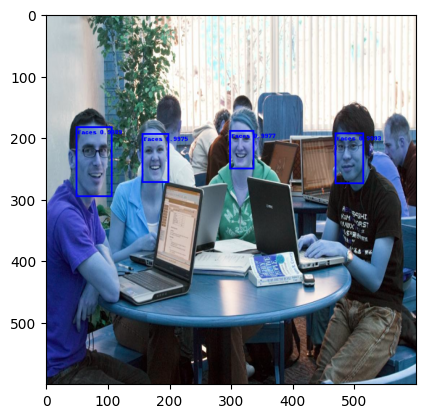

3


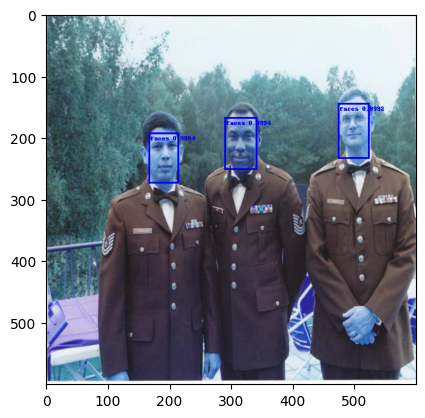

8


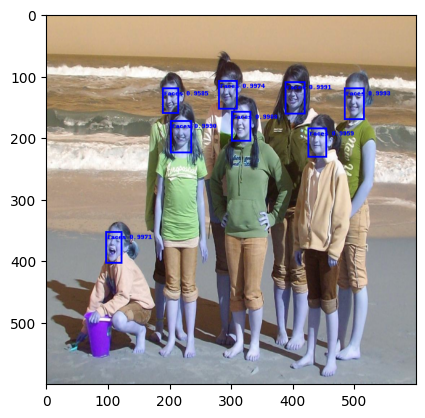

9


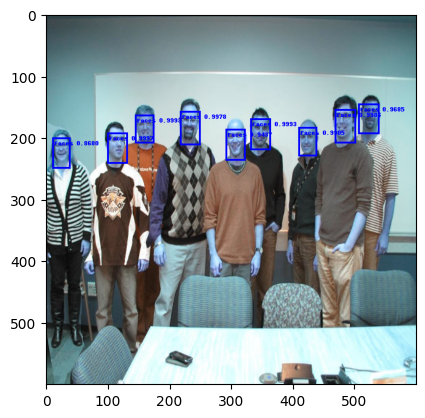

3


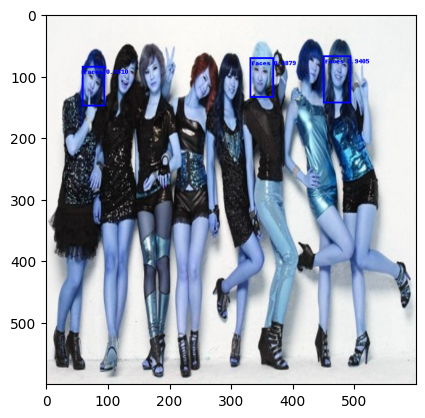

9


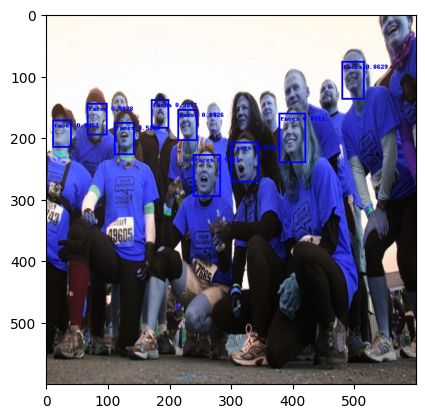

18


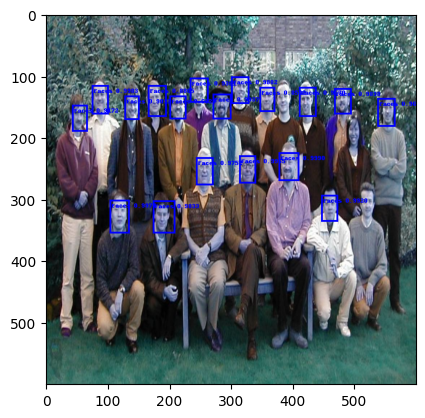

13


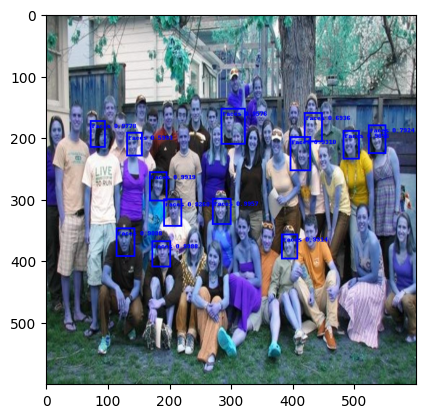

4


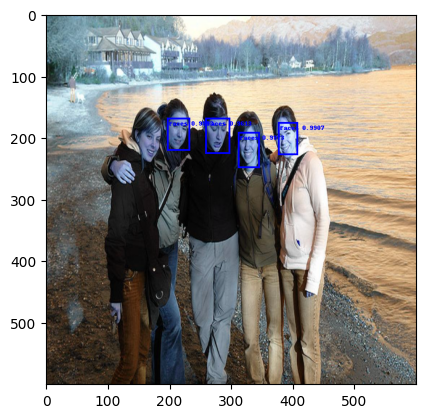

9


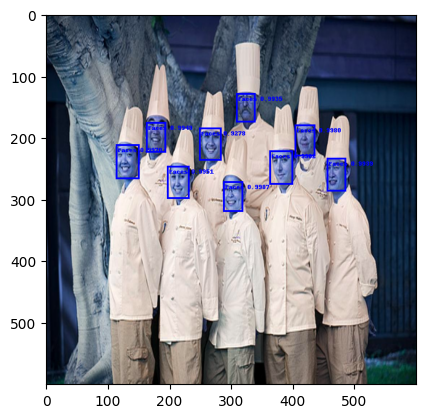

6


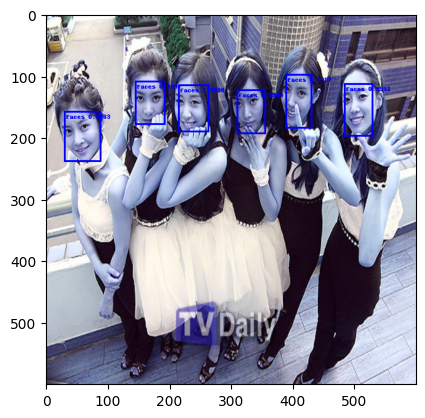

13


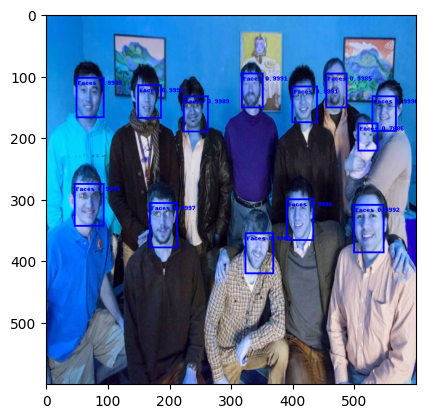

5


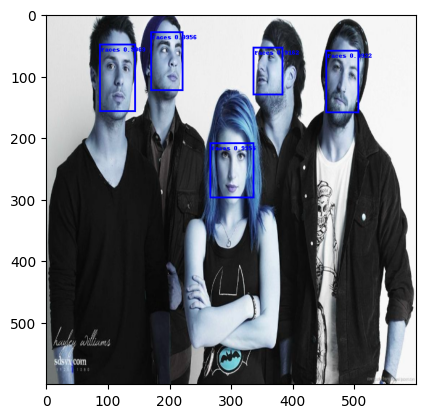

5


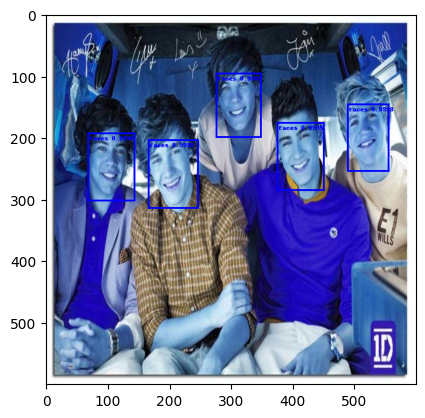

0


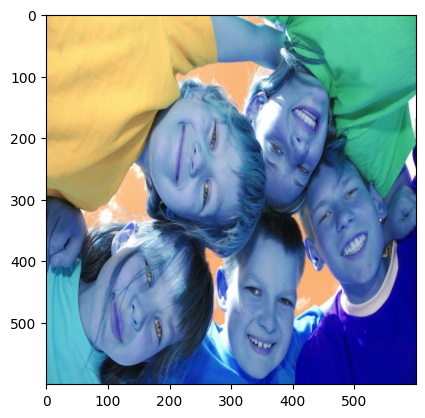

7


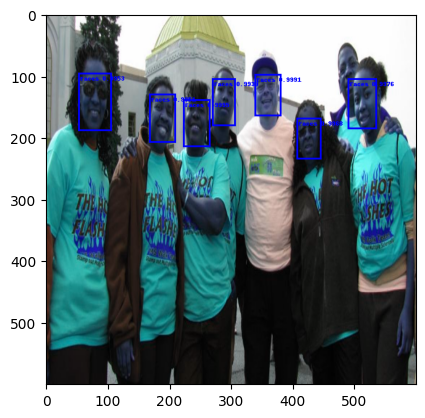

11


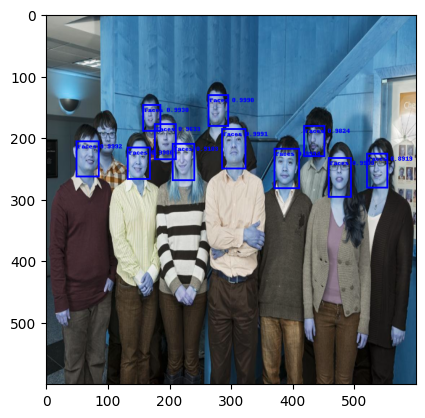

11


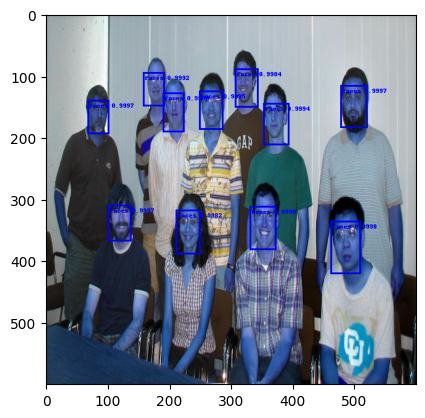

0


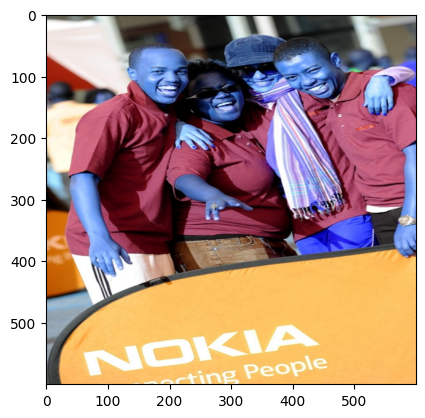

2


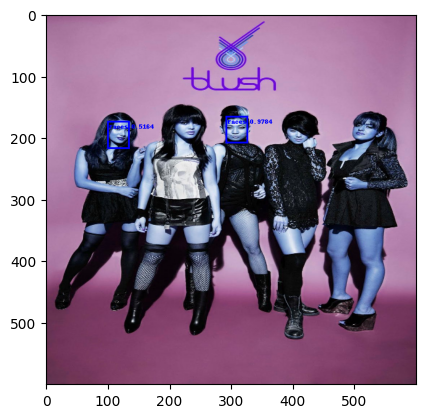

13


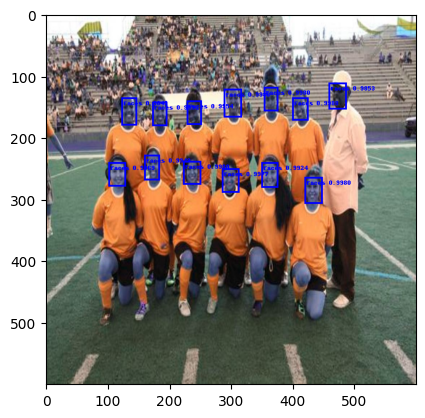

7


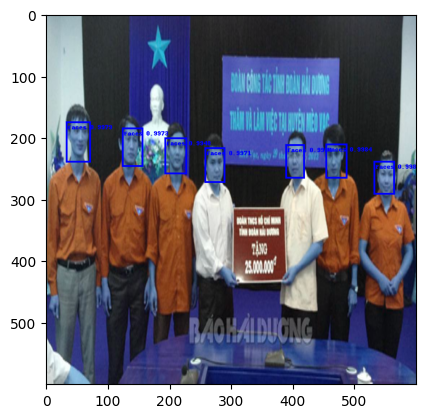

10


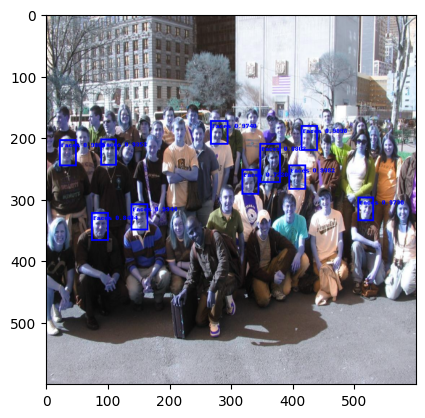

10


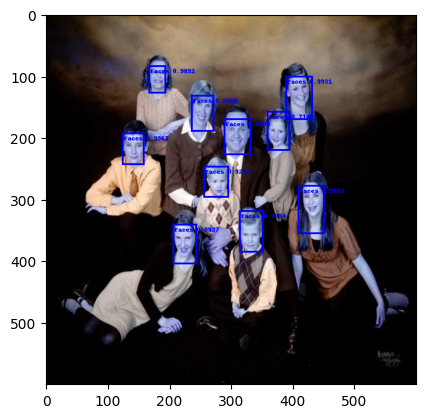

13


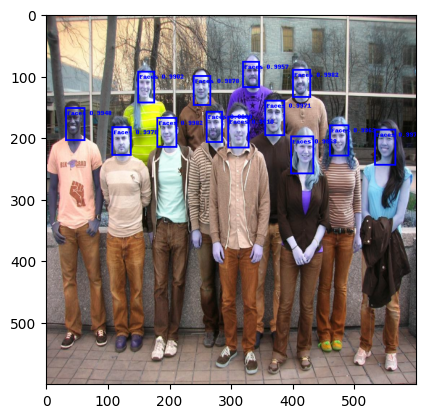

3


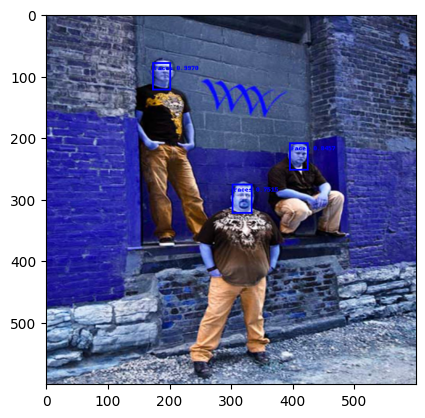

9


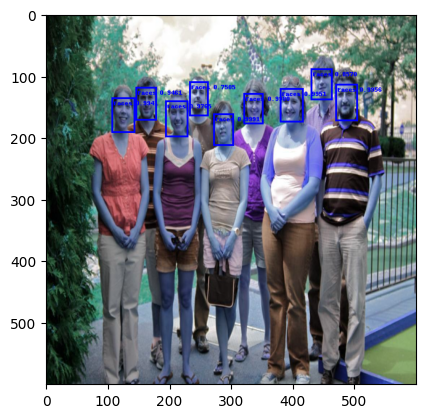

10


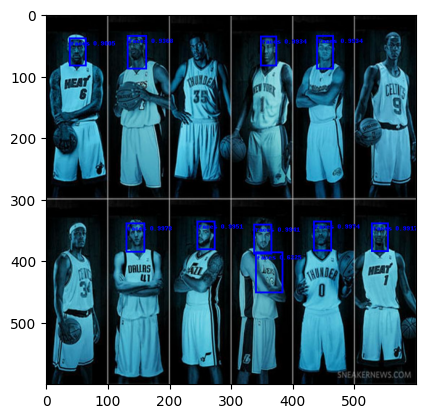

1


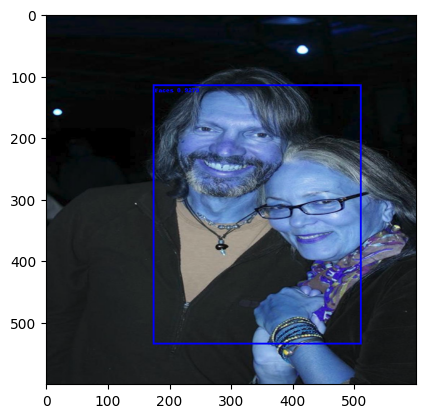

5


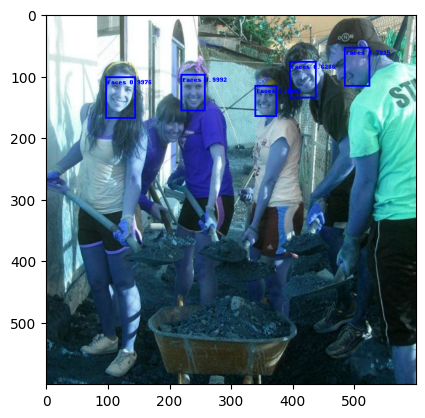

loading annotations into memory...
Done (t=0.00s)
creating index...
index created!
loading annotations into memory...
Done (t=0.00s)
creating index...
index created!
Grupo | Ruido
4


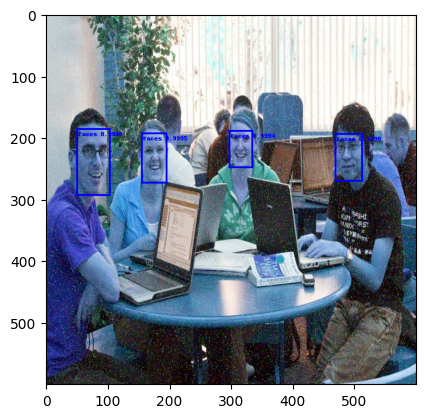

4


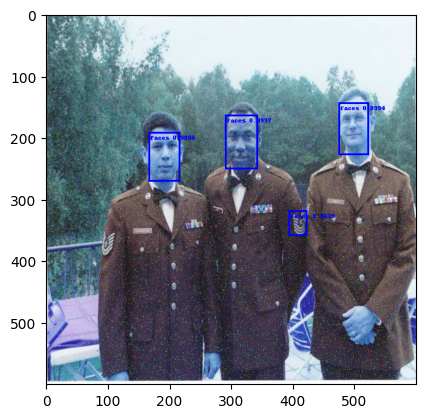

8


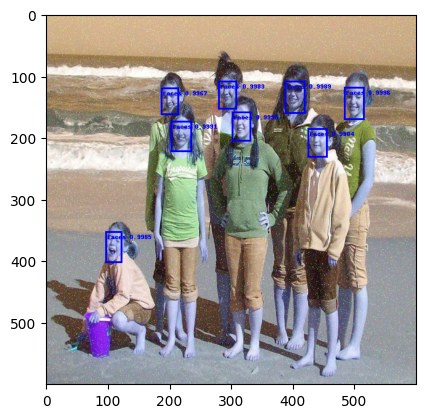

9


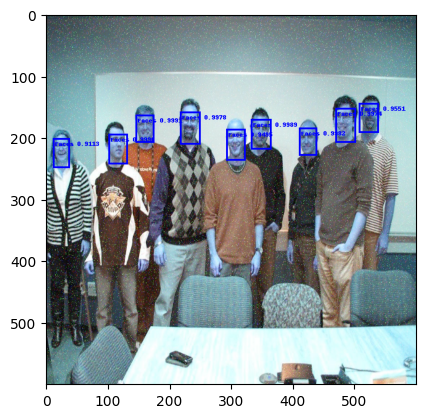

4


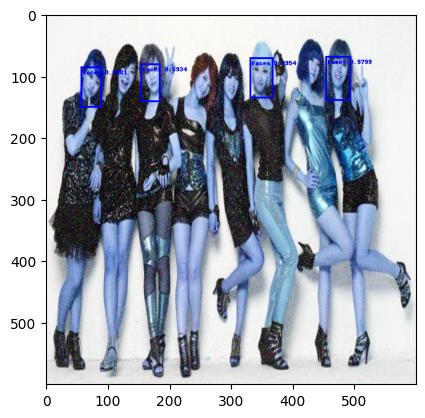

12


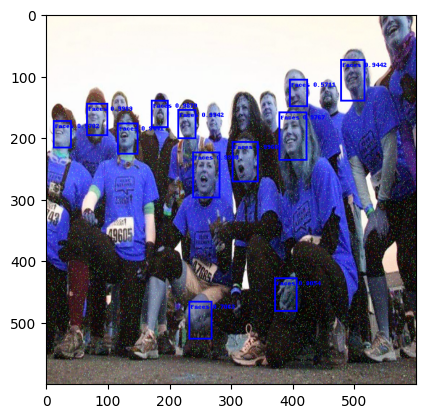

17


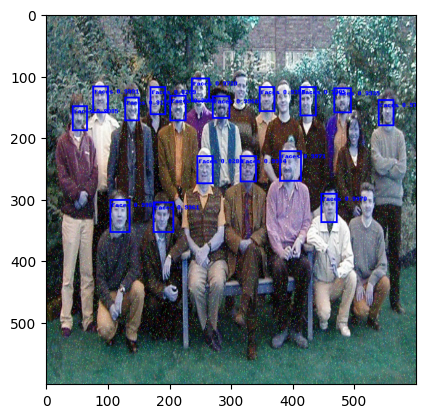

15


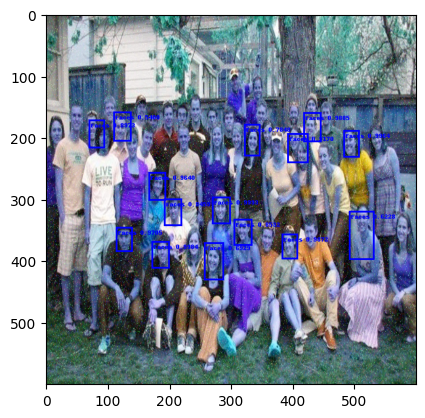

5


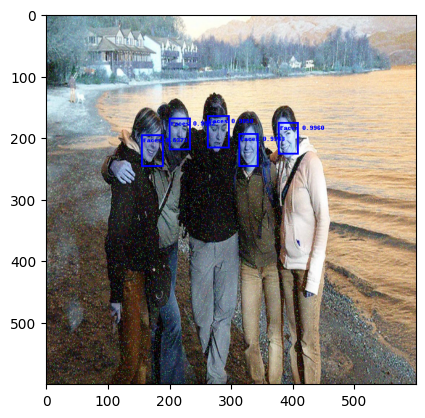

9


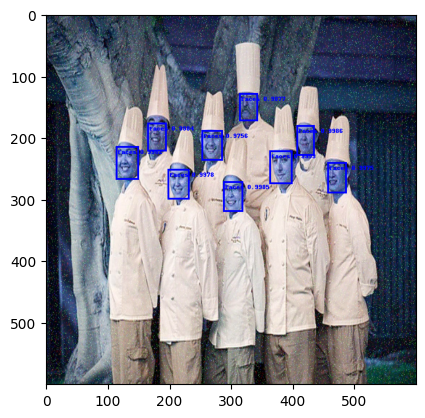

6


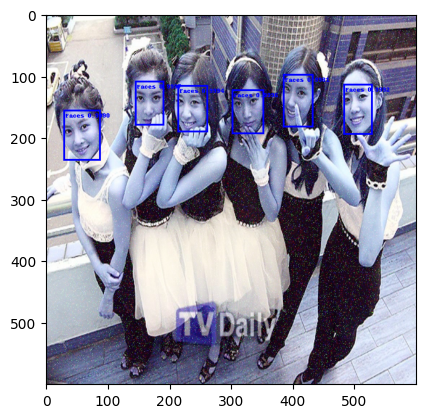

13


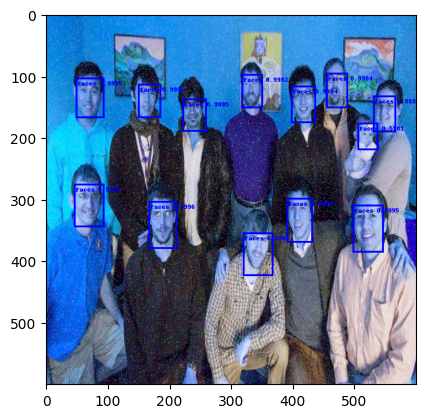

5


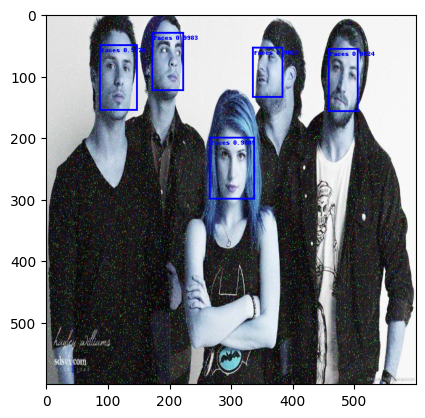

5


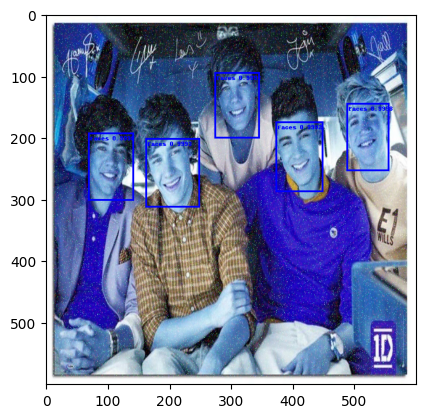

0


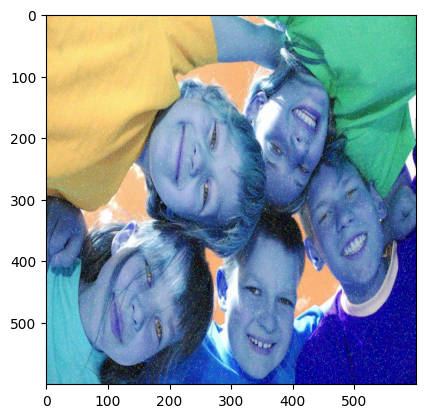

8


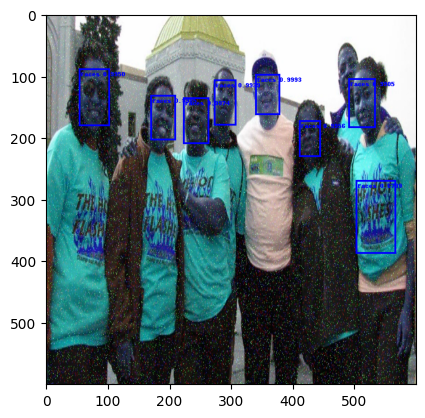

10


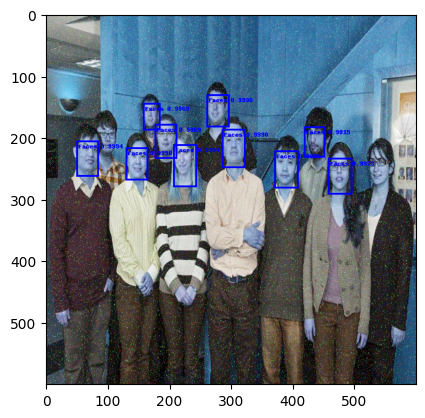

11


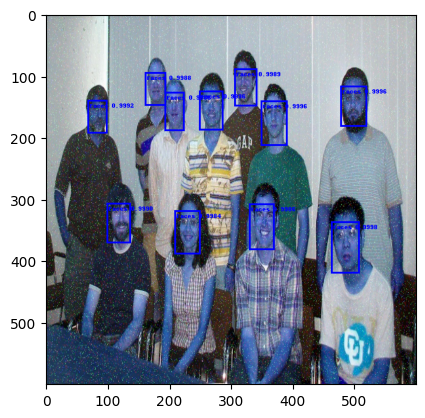

0


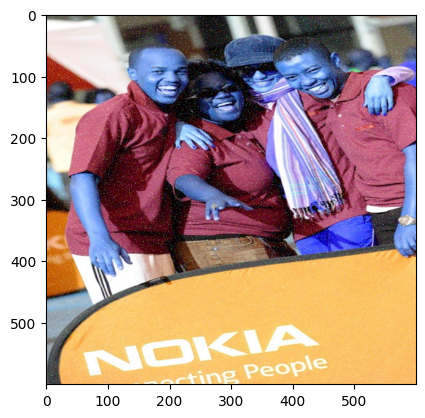

2


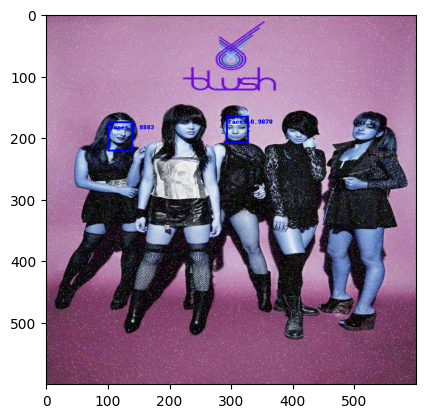

13


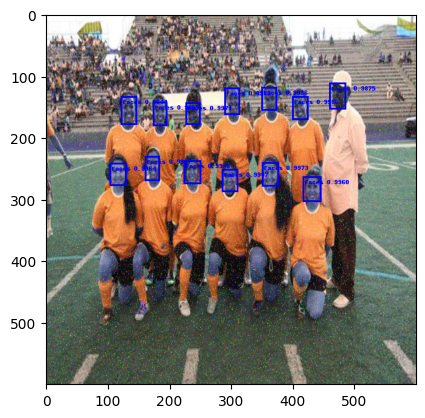

7


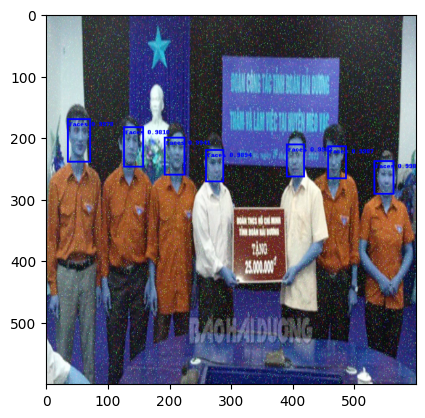

13


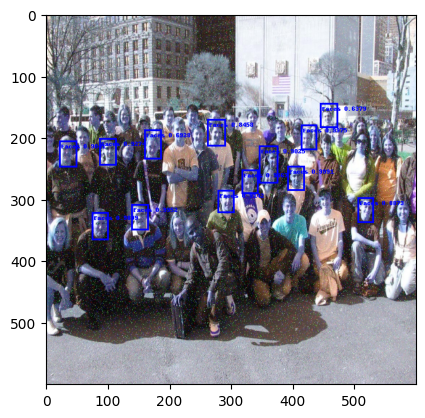

10


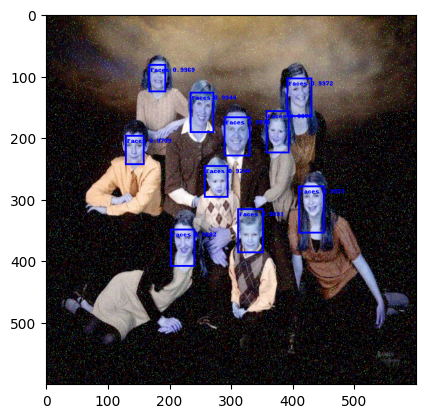

13


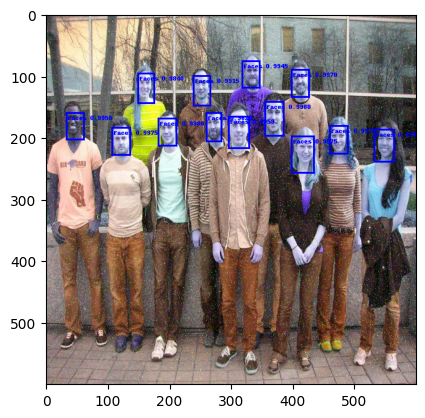

1


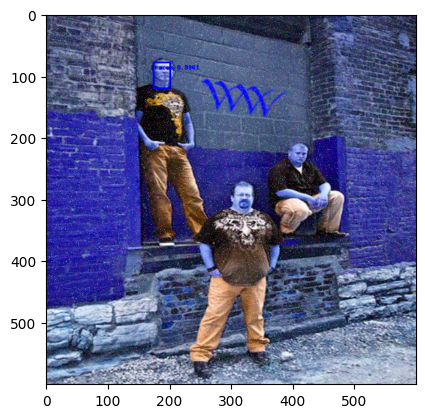

9


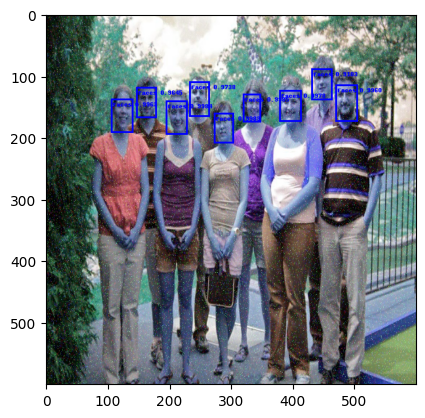

15


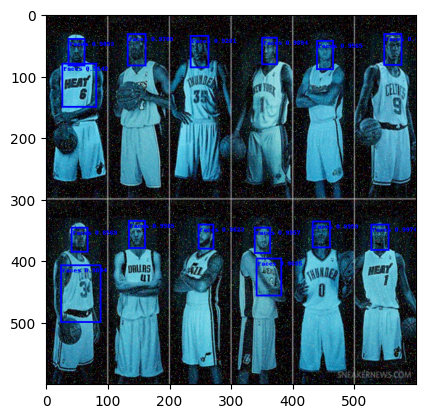

1


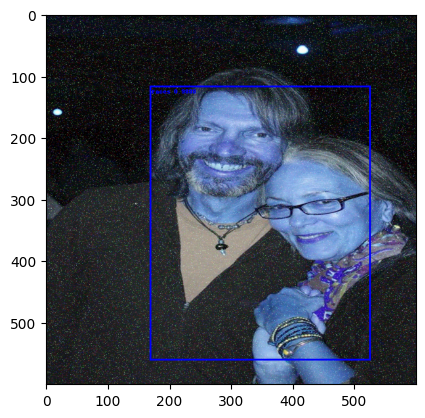

5


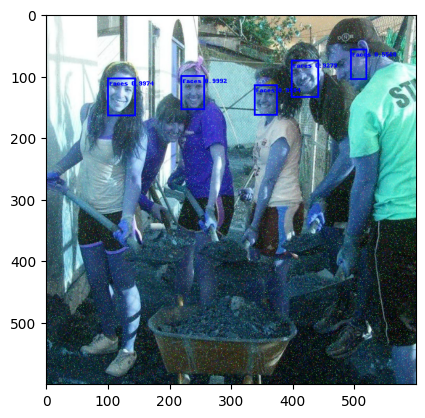

loading annotations into memory...
Done (t=0.01s)
creating index...
index created!
loading annotations into memory...
Done (t=0.00s)
creating index...
index created!
Grupo | Mais-Brilho
4


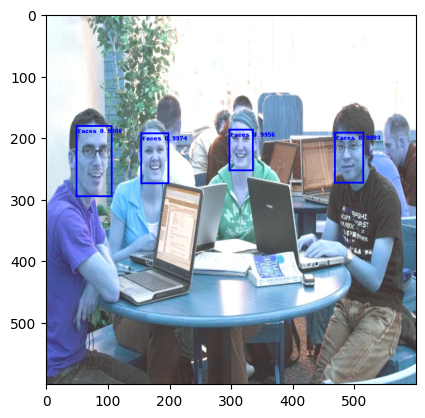

3


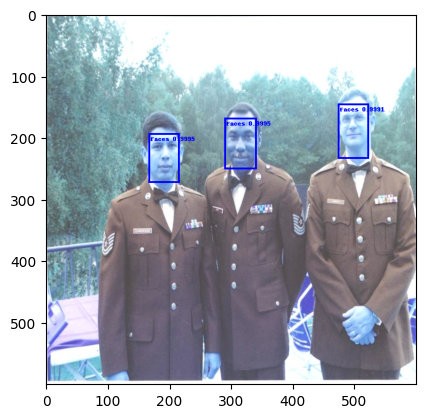

8


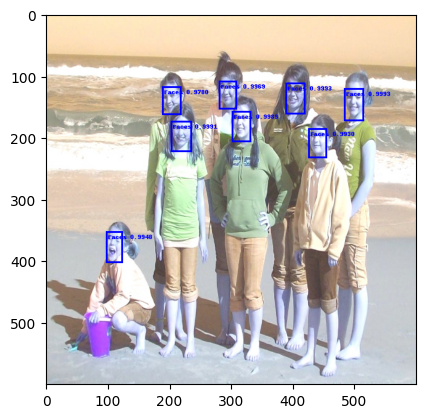

9


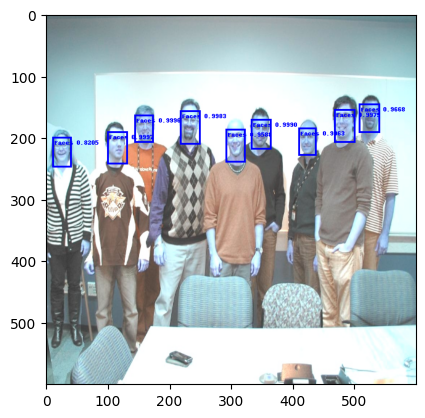

3


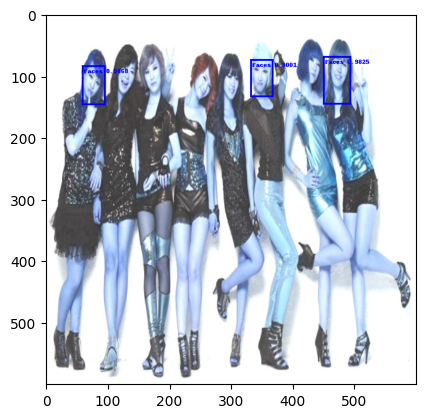

10


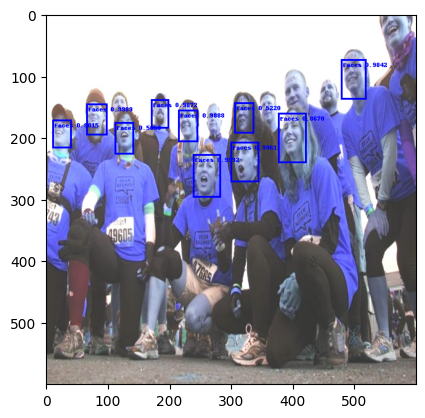

17


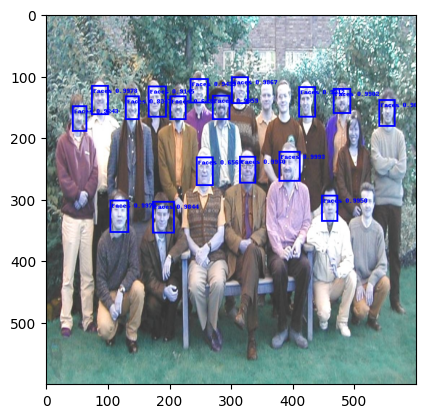

12


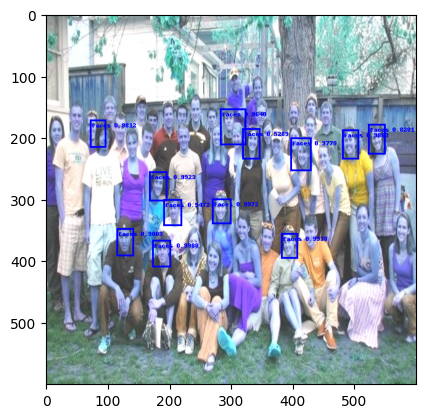

3


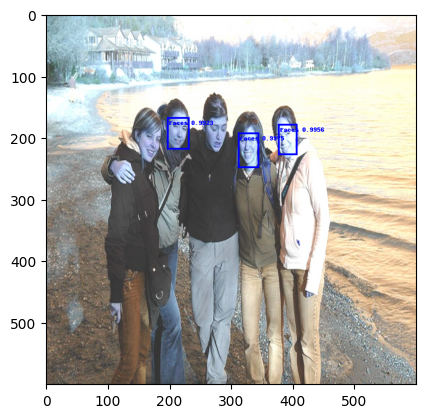

9


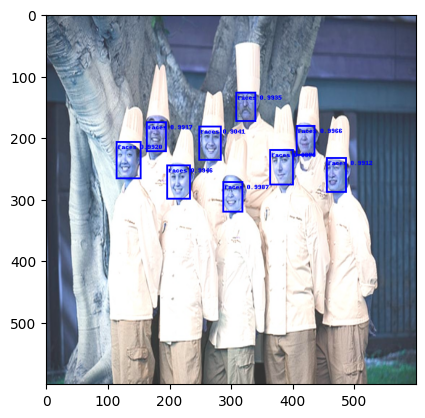

6


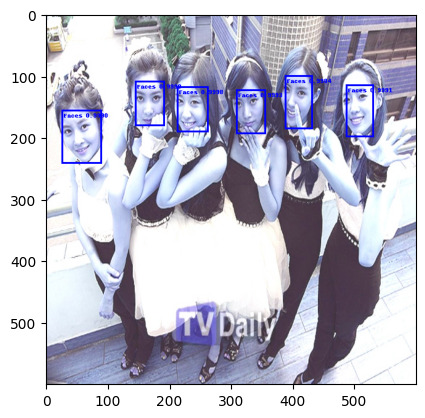

13


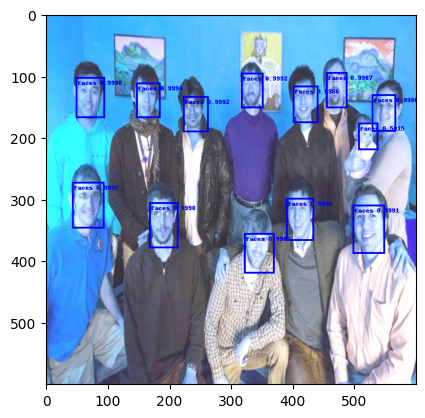

5


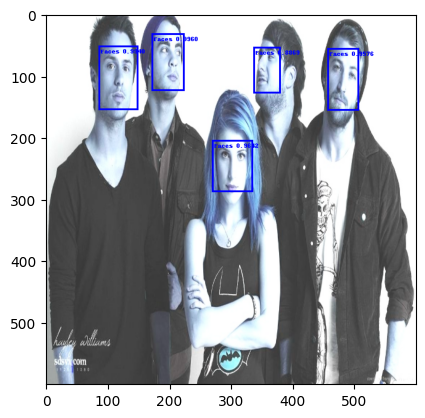

5


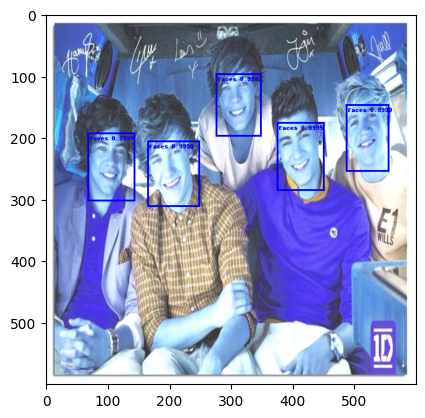

0


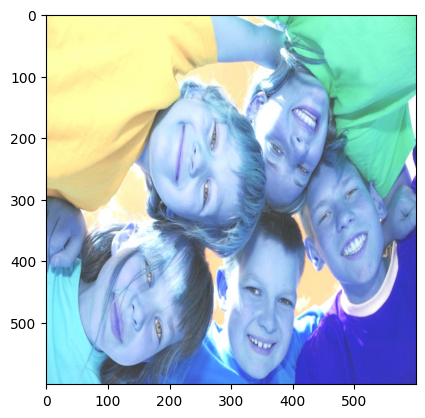

7


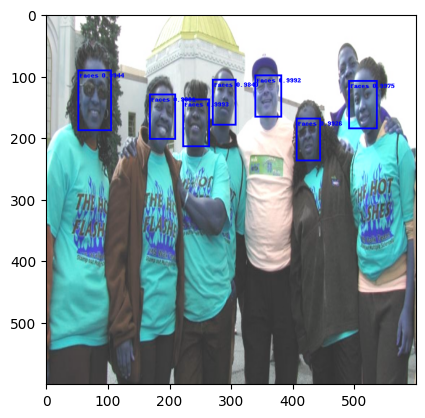

11


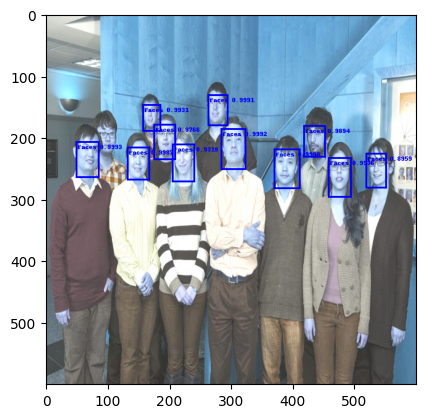

11


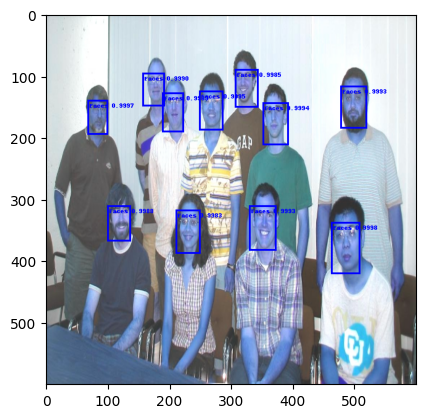

0


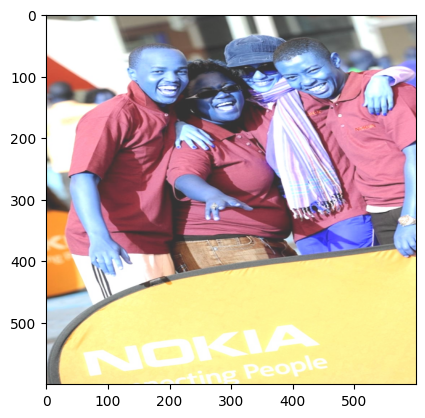

1


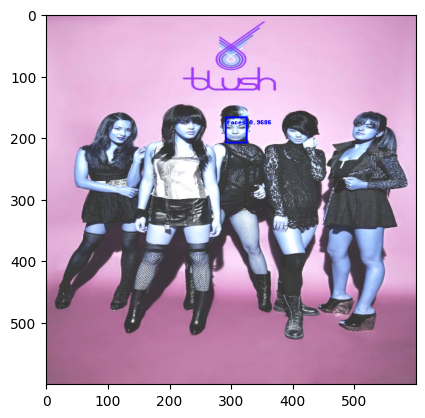

13


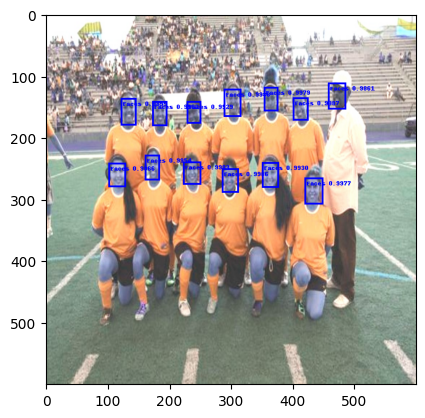

7


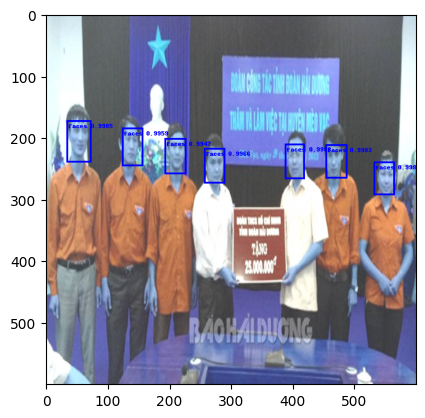

9


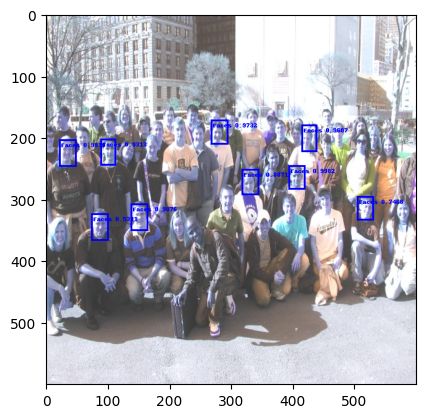

10


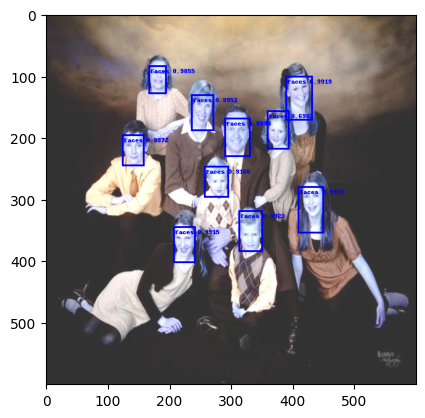

13


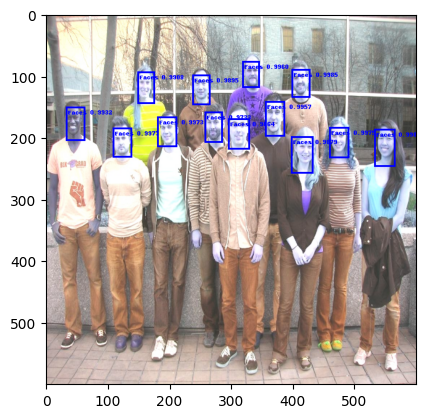

3


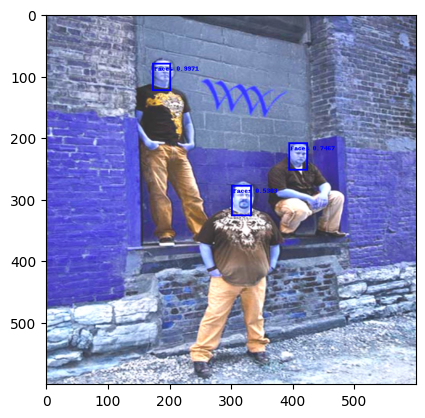

9


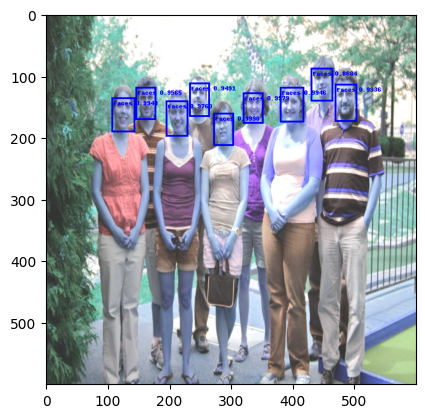

10


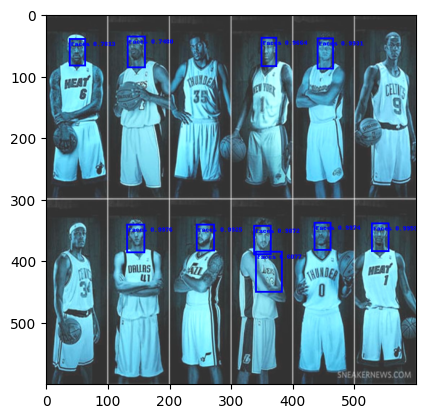

1


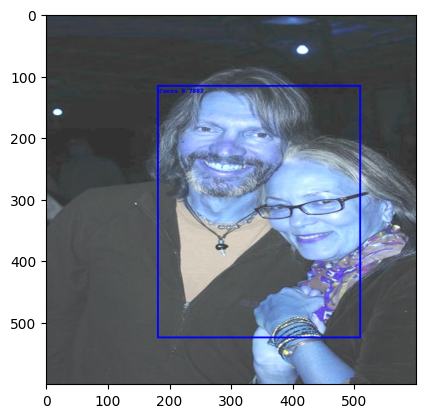

5


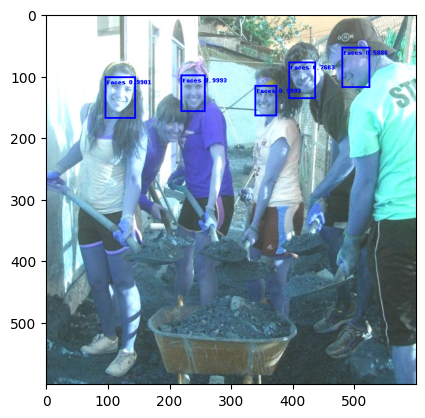

loading annotations into memory...
Done (t=0.00s)
creating index...
index created!
loading annotations into memory...
Done (t=0.00s)
creating index...
index created!
Grupo | Menos-Brilho
4


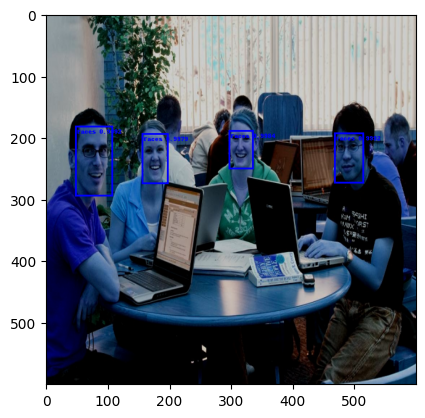

3


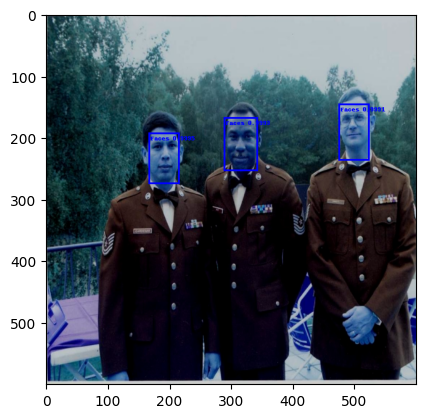

8


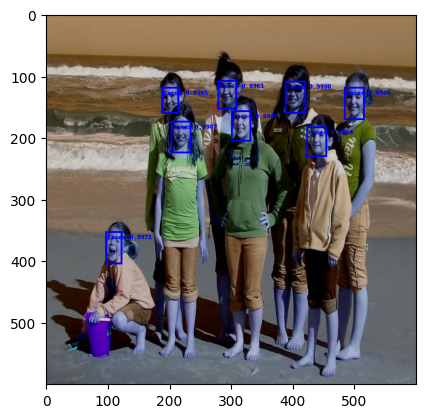

9


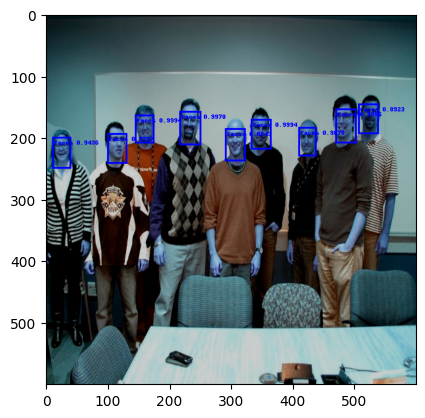

3


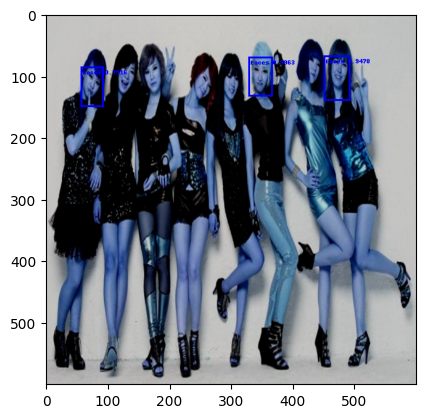

10


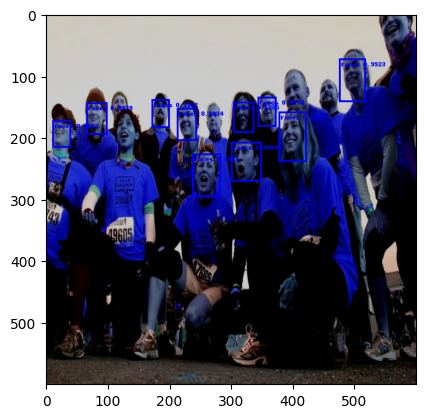

17


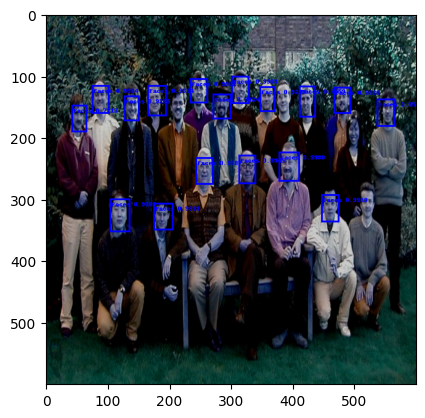

13


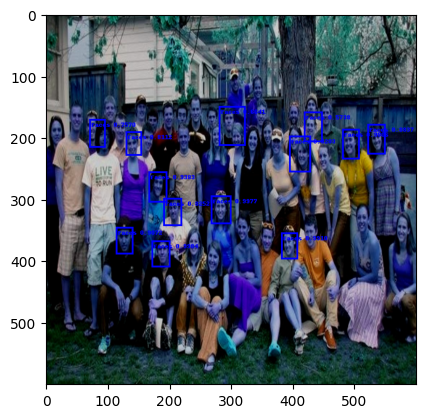

3


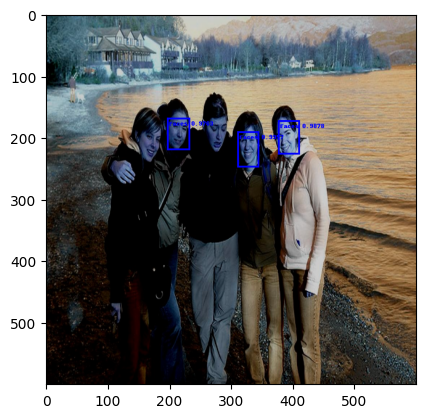

9


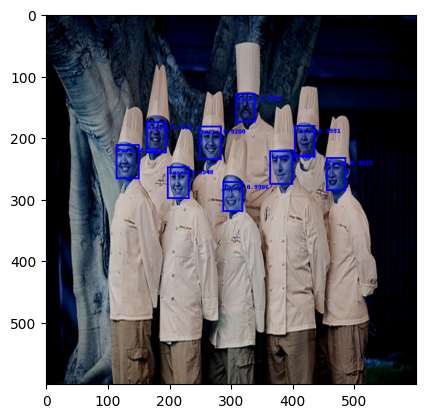

6


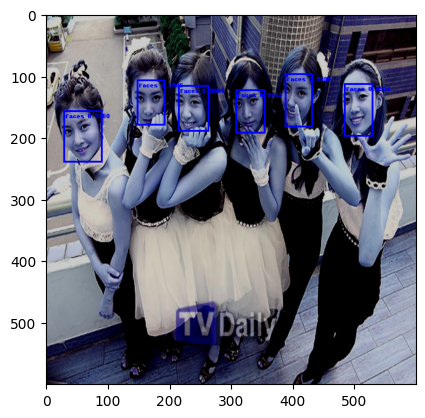

13


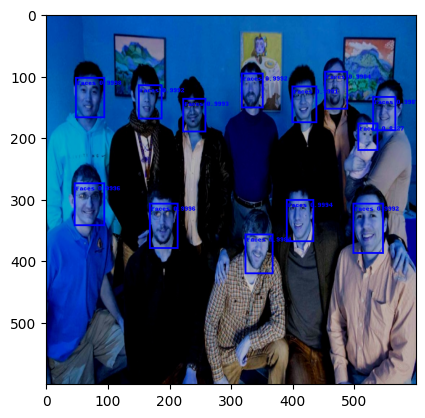

5


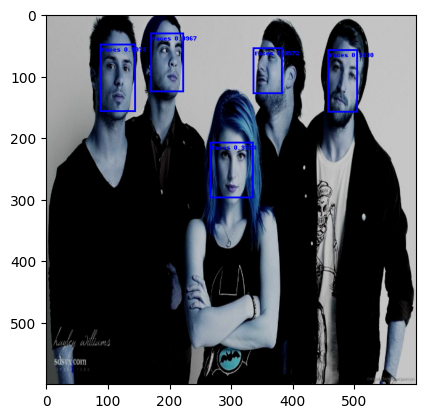

5


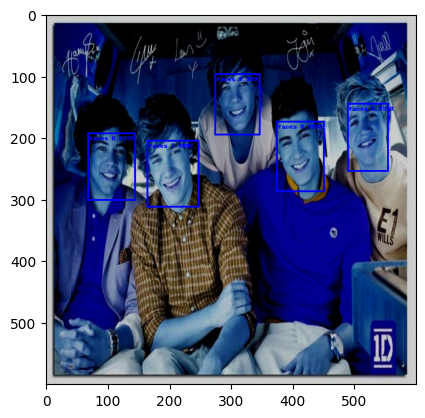

1


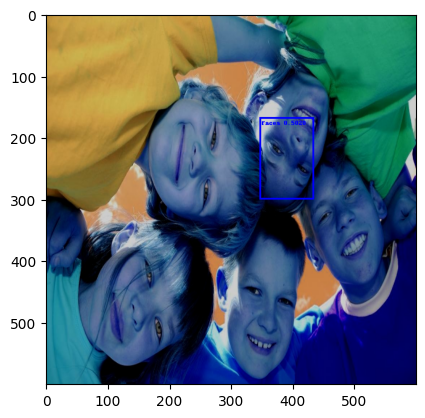

6


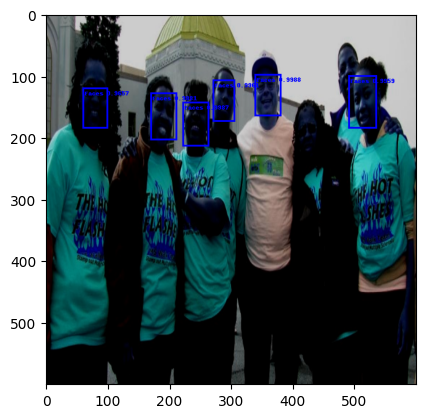

11


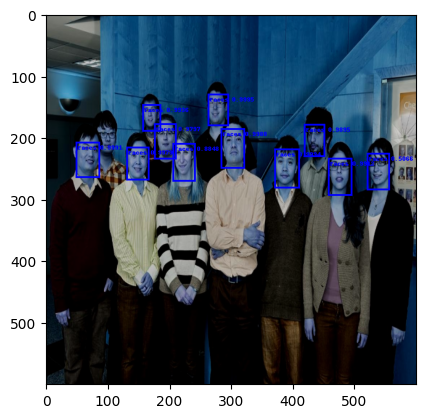

11


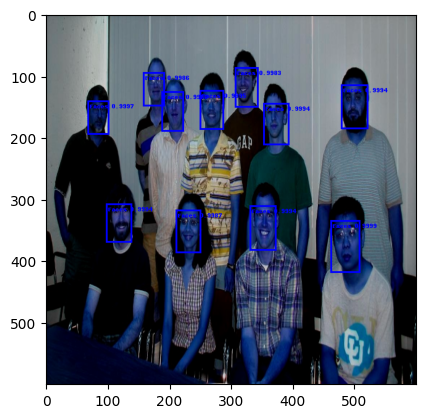

1


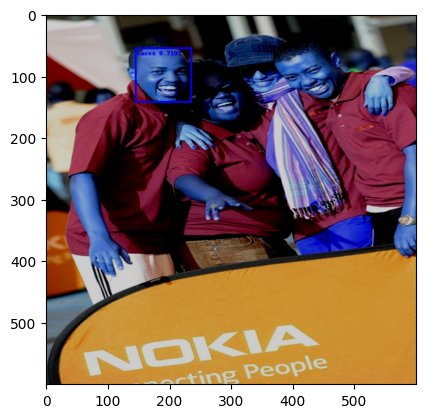

1


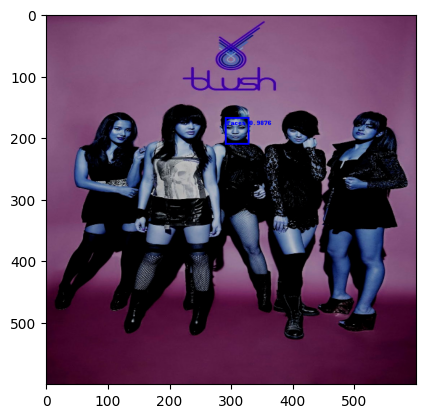

13


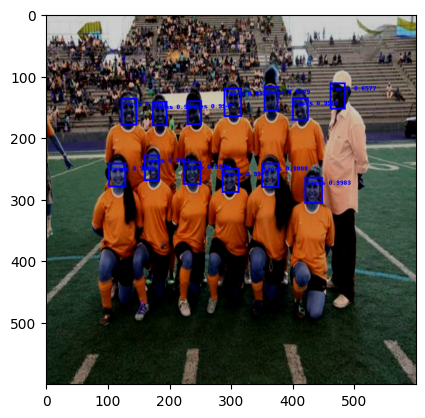

7


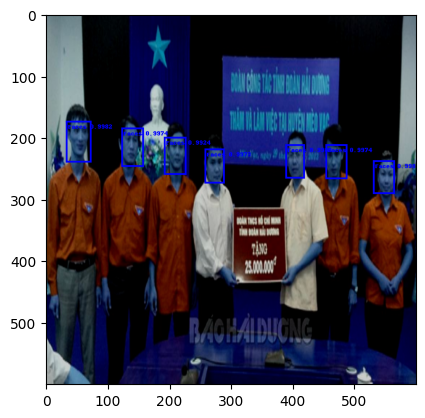

10


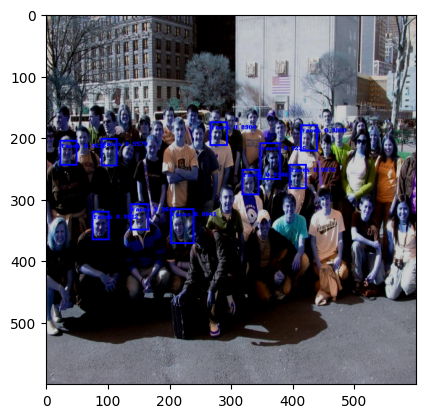

10


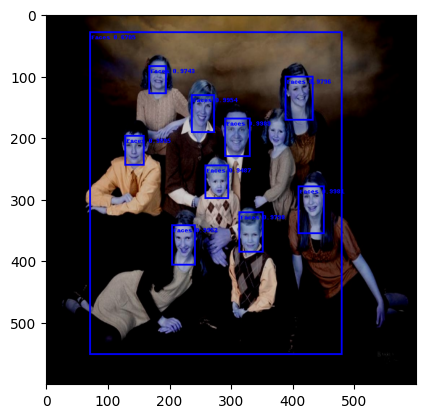

13


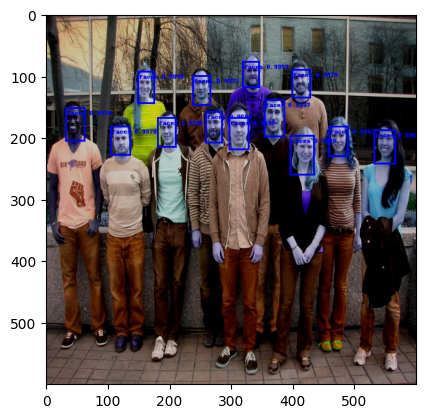

3


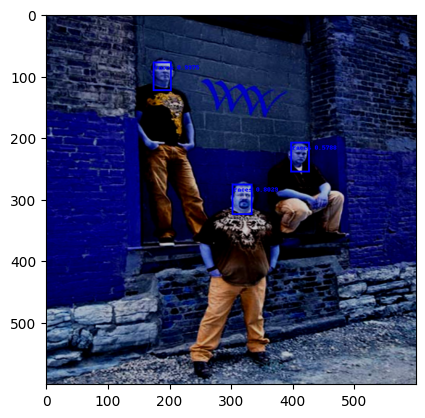

9


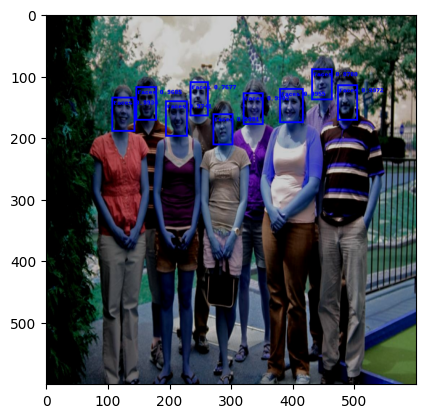

12


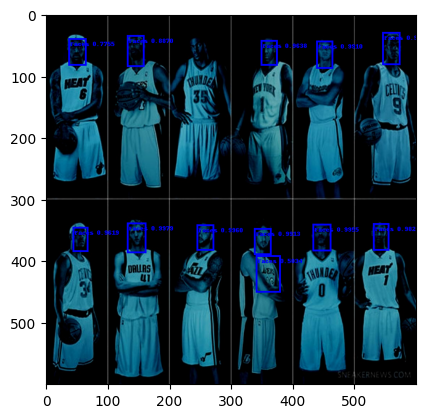

1


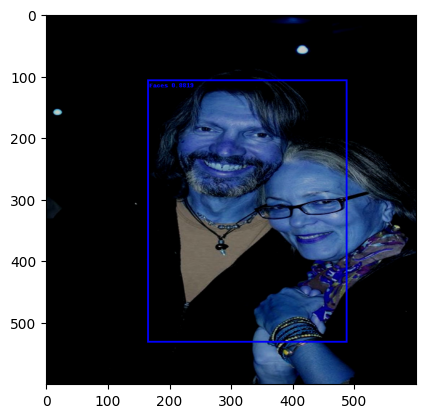

4


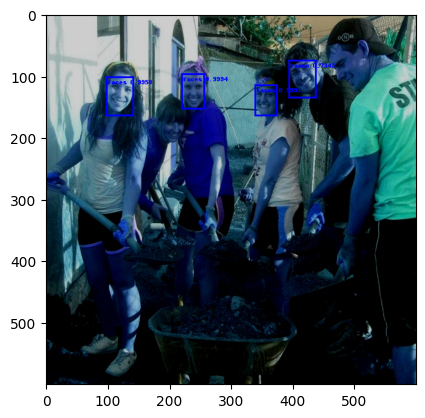

Acabei


In [58]:
splitDataset = "Grupo/Normal"
saveSplit = "Result Test/Grupo/CNN/Normal"
test_dataset = FaceDetection(root=samplesDataset, split=splitDataset, transforms=get_transforms(False))
test = COCO(os.path.join(samplesDataset, splitDataset, "_annotations.coco.json"))
print("Grupo | Normal")
executeInference()

splitDataset = "Grupo/Ruido"
saveSplit = "Result Test/Grupo/CNN/Ruido"
test_dataset = FaceDetection(root=samplesDataset, split=splitDataset, transforms=get_transforms(False))
test = COCO(os.path.join(samplesDataset, splitDataset, "_annotations.coco.json"))
print("Grupo | Ruido")
executeInference()

splitDataset = "Grupo/Mais-Brilho"
saveSplit = "Result Test/Grupo/CNN/Mais-Brilho"
test_dataset = FaceDetection(root=samplesDataset, split=splitDataset, transforms=get_transforms(False))
test = COCO(os.path.join(samplesDataset, splitDataset, "_annotations.coco.json"))
print("Grupo | Mais-Brilho")
executeInference()

splitDataset = "Grupo/Menos-Brilho"
saveSplit = "Result Test/Grupo/CNN/Menos-Brilho"
test_dataset = FaceDetection(root=samplesDataset, split=splitDataset, transforms=get_transforms(False))
test = COCO(os.path.join(samplesDataset, splitDataset, "_annotations.coco.json"))
print("Grupo | Menos-Brilho")
executeInference()
print("Acabei")

In [57]:
def executeInference():
    for i in range(30):
        # Imagem atual
        img, _ = test_dataset[i]
        img_int = torch.tensor(img*255, dtype=torch.uint8)
        img_name = test.loadImgs(i)[0]['file_name']
        img_name_split = img_name.split('.')
        img_name = img_name_split[0]+'.jpg'
        # Desabilitando o calculo do gradiente para redução do consumo de memória
        with torch.no_grad():
            prediction = model([img.to(device)]) # Realiza a detecção, mandando a imagem para o modelo
            pred = prediction[0]
            labels = []
            scores = pred['scores'].cpu().detach().numpy() # Pega todos as detecções realizada pelo modelo e realiza a conversão para um lista numpy
    #     print(len(pred['boxes'][pred['scores'] > 0.01]))

    #     print(scores)
        for i in range(len(scores)):
            # Classe (Em nosso caso temos apenas uma classe, porém em caso de mais classes é ulizado uma lista )
            classe = "Faces"
            score = scores[i] # Score atual
            if(score > 0.5): # Theshold do score
                label = f"{classe} {score:0.4f}" # Label do bounding box
                labels.append(label) # Append do label
        print(len(labels))
    #     savePath = "./Result Test/" + img_name
        savePath = os.path.join("./", saveSplit, img_name)
        saveImg = draw_bounding_boxes(img_int,
        pred['boxes'][pred['scores'] > 0.5],
        [labels[i] for i in range(len(labels))],
        width=3,
        colors=(255,0,0))


    #     img = Image.fromarray(saveImg.cpu().detach().numpy()[1])
    #     img.save(savePath)

        r = saveImg.cpu().numpy()[0]
        g = saveImg.cpu().numpy()[1]
        b = saveImg.cpu().numpy()[2]
        rgb = np.dstack((r,g,b))
        save = cv2.cvtColor(rgb, cv2.COLOR_RGB2BGR)
        imgplot = plt.imshow(save)
        plt.show()
        cv2.imwrite(savePath, save)